<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstoneprj/blob/main/ImageCaptiongenerator_Transformer_Resnet50_Flickr30.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# New Section

To download Flickr Data set and unzip it . It has 8000 images and we will be using 5000 for training , 1000 validation and 2000 for testing 

In [ ]:
#Importing all libraries for Keras , Tensorflow and Resnet50

In [ ]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle
import tensorflow as tf
import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
#from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
!pip uninstall tensorflow
!pip install tensorflow==2.0

In [ ]:
from tensorflow.keras.applications.resnet50 import ResNet50

In [ ]:
!pip install tensorflow

In [ ]:
from sklearn.utils import shuffle

In [ ]:
import os #/content/gdrive/MyDrive
os.chdir('/content/drive/MyDrive/Project Files/')
# os.chdir('/content/')

In [ ]:
!zipfiles '/content/drive/MyDrive/Project Files/flickr30k_1'

/bin/bash: zipfiles: command not found


In [ ]:
os.chdir('/content/sample_data/')

In [ ]:
https://drive.google.com/file/d/1gqnYlRwSU4Qiqkwpmj6Q-yjLuaESi0ay/view?usp=sharing
https://drive.google.com/drive/folders/1bYCzjGFUqW6Kf741wEHepv6vQIzCsMS-?usp=sharing

In [ ]:
! gdown --id 1gqnYlRwSU4Qiqkwpmj6Q-yjLuaESi0ay

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1gqnYlRwSU4Qiqkwpmj6Q-yjLuaESi0ay
To: /content/drive/MyDrive/Project Files/flickr30k.zip
100% 4.38G/4.38G [00:34<00:00, 126MB/s]


In [ ]:
https://drive.google.com/file/d/1--mY-Pziz9TTvvX5j_wlKwPiED8oQ3wb/view?usp=sharing
https://drive.google.com/file/d/1XMDFPpFbhWnQ1aMR8SnF00CkCAwvOPmr/view?usp=sharing
https://drive.google.com/file/d/1-J0LUdMRr9QjzsMSFAp_M3LaYo4L8Zf5/view?usp=sharing
https://drive.google.com/file/d/1wbCMQIZWuR7XrNWMSgdpvIuOLhm11Ew0/view?usp=sharing
https://drive.google.com/file/d/1WKrWL1YNH2hhZh4PnctnWdo-fuBcRnjU/view?usp=sharing

In [ ]:
os.chdir('/content/sample_data/')
! gdown --id 1WKrWL1YNH2hhZh4PnctnWdo-fuBcRnjU


/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1WKrWL1YNH2hhZh4PnctnWdo-fuBcRnjU
To: /content/sample_data/flickr30k_4.zip
100% 954M/954M [00:03<00:00, 278MB/s]


In [ ]:
os.chdir('/content/sample_data/')
! gdown --id 1--mY-Pziz9TTvvX5j_wlKwPiED8oQ3wb
! gdown --id 1XMDFPpFbhWnQ1aMR8SnF00CkCAwvOPmr
! gdown --id 1-J0LUdMRr9QjzsMSFAp_M3LaYo4L8Zf5
! gdown --id 1WKrWL1YNH2hhZh4PnctnWdo-fuBcRnjU


In [ ]:
!rename "flickr30k_4-20220818T082126Z-001" "flickr30k_4"
!rm -r /content/sample_data/flickr30k_4

In [ ]:
!pip install kaggle
{"username":"monicarn","key":"4b125aeee7d3ea9a2bd40fc64326ed6d"}
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json

api_token = {"username":"monicarn","key":"4b125aeee7d3ea9a2bd40fc64326ed6d"}

import json

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)

!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d hsankesara/flickr-image-dataset

In [ ]:
!unzip "flickr30k.zip" 

In [ ]:
!unzip -FFv flickr30k.zip

In [ ]:
!7z x flickr30k.zip

In [ ]:
!apt install p7zip-full

In [ ]:
!zip -FF flickr30k.zip --out Repairedflickr30k.zip | unzip

In [ ]:
/content/sample_data/flickr30k_4-20220818T082126Z-001.zip

In [ ]:
!unzip /content/sample_data/flickr30k_4.zip

In [ ]:
!unzip /content/sample_data/flickr30k_1.zip
!unzip /content/sample_data/flickr30k_2.zip
!unzip /content/sample_data/flickr30k_3.zip
!unzip /content/sample_data/flickr30k_4-20220818T082126Z-001.zip

In [ ]:
!zip -r "flickr30k_2.zip" "flickr30k_2"
!zip -r "flickr30k_3.zip" "flickr30k_3"
!zip -r "flickr30k_4.zip" "flickr30k_4"

In [ ]:
import pandas as pd

In [ ]:
os.listdir()

In [ ]:
import os #/content/gdrive/MyDrive
os.chdir('/content/drive/MyDrive/Project Files/')

In [ ]:
#Read results_flickr30k.csv and retain only first two columns
#We have uploaded this csv into content folder on colab
data=pd.read_csv('results - Copy.csv')
data=data[['image_name',' comment']]

data.head()

,image_name,comment
0,1000092795.jpg,Two young guys with shaggy hair look at their...
1,1000092795.jpg,Two young White males are outside near many ...
2,1000092795.jpg,Two men in green shirts are standing in a yard .
3,1000092795.jpg,A man in a blue shirt standing in a garden .
4,1000092795.jpg,Two friends enjoy time spent together .


In [ ]:
#check Image file name to Caption combination derived from the Flick8 dataset

In [ ]:
data.isna().sum()

image_name    0
 comment      0
dtype: int64

In [ ]:
data[data[' comment'].isna()]

,image_name,comment


In [ ]:
data['Comment']=data['Comment'].fillna("")

In [ ]:
len(data)

158915

In [ ]:
uni_filenames = np.unique(data.image_name.values)
data.head()

,image_name,comment
0,1000092795.jpg,Two young guys with shaggy hair look at their...
1,1000092795.jpg,Two young White males are outside near many ...
2,1000092795.jpg,Two men in green shirts are standing in a yard .
3,1000092795.jpg,A man in a blue shirt standing in a garden .
4,1000092795.jpg,Two friends enjoy time spent together .


Print some images along with captions to check the Flickr Data that was imported

In [ ]:
# Get all the words available i the captions by splitting the sentences

In [ ]:
data.columns

Index(['image_name', ' comment'], dtype='object')

In [ ]:
vocabulary = []
for txt in data[' comment'].values:
    #print(txt)
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 23456


In [ ]:
# crearting a list of Image file names and captions

In [ ]:
img = data["image_name"].tolist()
caption = data[" comment"].tolist()

In [ ]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 158915
len(caption) : 158915


' Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage\ngiving undesired results '

In [ ]:
""" Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage
giving undesired results """
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [ ]:
""" Cleaning up the original text without punctuations, single characters and numeric values """

' Cleaning up the original text without punctuations, single characters and numeric values '

In [ ]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data[' comment'].values):
    newcaption = text_clean(caption)
    data[' comment'].iloc[i] = newcaption

In [ ]:
#building clean vocabulary
clean_vocabulary = []
for txt in data[' comment'].values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 20933


In [ ]:
for i in data[' comment'].astype(str):
    print(i)

In [ ]:
# adding <start> and <end> tags to sentences to identify the start and end of the sentences while looping through words in sentence

all_captions = []

for caption  in data[' comment'].astype(str):
    caption = '<start>' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start> Two young guys with shaggy hair look at their hands while hanging out in the yard <end>',
 '<start> Two young White males are outside near many bushes <end>',
 '<start> Two men in green shirts are standing in yard <end>',
 '<start> man in blue shirt standing in garden <end>',
 '<start> Two friends enjoy time spent together <end>',
 '<start> Several men in hard hats are operating giant pulley system <end>',
 '<start> Workers look down from up above on piece of equipment <end>',
 '<start> Two men working on machine wearing hard hats <end>',
 '<start> Four men on top of tall structure <end>',
 '<start> Three men on large rig <end>']

In [ ]:
'<start>Two young guys with shaggy hair look at their hands while hanging out in the yard <end>'

In [ ]:
PATH1='/content/sample_data/flickr30k_1'
PATH2='/content/sample_data/flickr30k_2'
PATH3='/content/sample_data/flickr30k_3'
PATH4='/content/sample_data/flickr30k_4'

In [ ]:
PATH='/content/flickr30k'
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["image_name"]:
    full_image_path = PATH + '/' + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

In [ ]:
PATH2

'/content/sample_data/flickr30k_2'

In [ ]:
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["image_name"]:
    if os.path.exists(PATH1 + '/' + annot):
        full_image_path = PATH1 + '/' + annot
    elif os.path.exists(PATH2 + '/' + annot):
        full_image_path = PATH2 + '/' + annot
    elif os.path.exists(PATH3 + '/' + annot):
        full_image_path = PATH3 + '/' + annot
    else:
        full_image_path = PATH4 + '/' + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/sample_data/flickr30k_2/1000092795.jpg',
 '/content/sample_data/flickr30k_2/1000092795.jpg',
 '/content/sample_data/flickr30k_2/1000092795.jpg',
 '/content/sample_data/flickr30k_2/1000092795.jpg',
 '/content/sample_data/flickr30k_2/1000092795.jpg',
 '/content/sample_data/flickr30k_1/10002456.jpg',
 '/content/sample_data/flickr30k_1/10002456.jpg',
 '/content/sample_data/flickr30k_1/10002456.jpg',
 '/content/sample_data/flickr30k_1/10002456.jpg',
 '/content/sample_data/flickr30k_1/10002456.jpg']

In [ ]:
for i in all_img_name_vector:
    if i=='/content/drive/MyDrive/Project Files/flickr30k_4/7617087498.jpg.npy':
        print('yes')

In [ ]:
all_img_name_vector

In [ ]:
print(os.path)

<module 'posixpath' from '/usr/lib/python3.7/posixpath.py'>


In [ ]:
#Not related to this colab
images = '/content/drive/MyDrive/Project Files/flickr30/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')

import shutil, os
for f in img:
    shutil.copy('/content/drive/MyDrive/Project Files/flickr30k_1/', '/content/drive/MyDrive/Project Files/flickr30/')
import shutil, os
for f in tqdm(img):
    shutil.copy(f, '/content/drive/MyDrive/Project Files/flickr30/')
for img_ in img:
    os.remove(img_)


In [ ]:
import shutil, os
for f in img:
    shutil.copytree('/content/drive/MyDrive/Project Files/flickr30k_1/', '/content/flickr30k')

In [ ]:
# Below path contains all the images
images = '/content/drive/MyDrive/Project Files/flickr30k_1/'
# Create a list of all image names in the directory
img = glob.glob(images + '*.jpg')
images = '/content/drive/MyDrive/Project Files/flickr30k_2/'
# Create a list of all image names in the directory
img.extend(glob.glob(images + '*.jpg'))
images = '/content/drive/MyDrive/Project Files/flickr30k_3/'
# Create a list of all image names in the directory
img.extend(glob.glob(images + '*.jpg'))
images = '/content/drive/MyDrive/Project Files/flickr30k_4/'
# Create a list of all image names in the directory
img.extend(glob.glob(images + '*.jpg'))

NameError: ignored

In [ ]:
len(all_img_name_vector)

158915

In [ ]:
all_captions[0]

'<start>  Two young guys with shaggy hair look at their hands while hanging out in the yard <end>'

In [ ]:
all_img_name_vector[0]

'/content/sample_data/flickr30k_2/1000092795.jpg'

In [ ]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 158915
len(all_captions) : 158915


In [ ]:
all_captions[0]

'<start> Two young guys with shaggy hair look at their hands while hanging out in the yard <end>'

In [ ]:
from PIL import Image
im=Image.open(all_img_name_vector[0])
im.show()

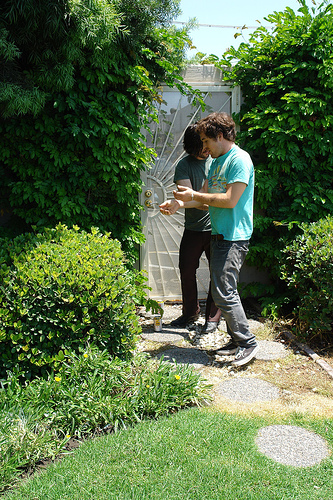

In [ ]:
display(im)

In [ ]:
import cv2
img = cv2.imread(all_img_name_vector[0])
#crop_img = img[y:y+h, x:x+w]
cv2.imshow(img)
cv2.waitKey(0)

In [ ]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [ ]:
train_captions,img_name_vector = data_limiter(158915,all_captions,all_img_name_vector)

In [ ]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 158915
len(all_captions) : 158915


In [ ]:
#Loading an image with (224,224,3) for passing to Encoder Resnet50
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    return img, image_path

In [ ]:
#Using Pretrained Resnet50 as encoder and taking Input size of (224,224,3)
image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")
new_input = image_model.input
hidden_layer = image_model.layers[-2].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

In [ ]:
image_features_extract_model.summary()

In [ ]:
image_model.summary()

In [ ]:
type(image_dataset)

tensorflow.python.data.ops.dataset_ops.BatchDataset

In [ ]:
type(img_name_vector)

list

In [ ]:
# Check libcudnn8 version
!apt-cache policy libcudnn8

# Install latest version
!apt install --allow-change-held-packages libcudnn8=8.4.1.50-1+cuda11.6

# Export env variables
!export PATH=/usr/local/cuda-11.4/bin${PATH:+:${PATH}}
!export LD_LIBRARY_PATH=/usr/local/cuda-11.4/lib64:$LD_LIBRARY_PATH
!export LD_LIBRARY_PATH=/usr/local/cuda-11.4/include:$LD_LIBRARY_PATH
!export LD_LIBRARY_PATH=$LD_LIBRARY_PATH:/usr/local/cuda/extras/CUPTI/lib64

# Install tensorflow
!pip install tflite-model-maker==0.4.0
!pip uninstall -y tensorflow && pip install -q tensorflow==2.9.1
!pip install pycocotools==2.0.4
!pip install opencv-python-headless==4.6.0.66

In [ ]:
img_name_vector

In [ ]:
# Get unique images
encode_train = sorted(set(img_name_vector))

# Batch size 16
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)
#Building Image feature vector using Resnet50 Encoder
for img,path in tqdm(image_dataset):
#   print(img,path)
#   break
  batch_features = image_features_extract_model(img)
  #print("shape",batch_features.shape)
  #print("batch_features.shape[0]",batch_features.shape[0])
  #print("batch_features.shape[3]",batch_features.shape[2])
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 1987/1987 [03:31<00:00,  9.39it/s]


In [ ]:
!pip install tensorflow==2.8
!apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Setting up libcudnn8 (8.1.0.77-1+cuda11.2) ...


In [ ]:
for img1, path1 in tqdm(image_dataset):
  batch_features1 = image_features_extract_model(img1)
  print("shape",batch_features1.shape)
  print("batch_features.shape[0]",batch_features1.shape[0])
  print("batch_features.shape[1]",batch_features1.shape[1])
  print("batch_features.shape[2]",batch_features1.shape[2])
  print("batch_features.shape[3]",batch_features1.shape[3])
  batch_features2 = tf.reshape(batch_features1,
                              (batch_features1.shape[0], -1, batch_features1.shape[3]))
  print("shape",batch_features2.shape)
  print("batch_features2.shape[0]",batch_features2.shape[0])
  print("batch_features2.shape[1]",batch_features2.shape[1])
  print("batch_features2.shape[2]",batch_features2.shape[2])
  #print("batch_features2.shape[3]",batch_features2.shape[3])
  break

  0%|          | 0/1987 [00:00<?, ?it/s]

shape (16, 7, 7, 2048)
batch_features.shape[0] 16
batch_features.shape[1] 7
batch_features.shape[2] 7
batch_features.shape[3] 2048
shape (16, 49, 2048)
batch_features2.shape[0] 16
batch_features2.shape[1] 49
batch_features2.shape[2] 2048


### Preprocess and tokenize the captions

In [ ]:
top_k = 5000

In [ ]:
#Building a Word embedding for top 5000 words in the captions
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [ ]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
from pickle import dump,load

In [ ]:
pkl_tokenizer_file="/content/drive/MyDrive/Project Files/Pickle/encoded_tokenizer.pkl"

In [ ]:
# Save the tokenizer train features to disk
with open(pkl_tokenizer_file, "wb") as encoded_pickle:
    dump(tokenizer, encoded_pickle)


In [ ]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
cap_vector.shape # Maximum number of words in a sentence is 33 (in the captions dataset)

(158915, 74)

### Split the data into training and testing

In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [ ]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(127132, 127132, 31783, 31783)

In [ ]:
img_name_train, img_name_train2, cap_train, cap_train2 = train_test_split(img_name_train,
                                                                    cap_train,
                                                                    test_size=0.5,
                                                                    random_state=0)

In [ ]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(63566, 63566, 31783, 31783)

### Create a tf.data dataset for training

In [ ]:
BATCH_SIZE = 128
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [ ]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [ ]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [ ]:
# Position encoding for 1d vectors ( Word embedding)
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [ ]:
# Position encoding for 2d vectors (image)
#Input (Batch Size, H*W , Dense layer from Encoder)
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [ ]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [ ]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [ ]:
# This block build weights for Q - Query , K - Key , V - Value for the 8 heads
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [ ]:
""" This class build Multihead attention layer with number of heads passed ( 8 as per paper) and builds
Weigth for q - Query , k - Key , v - Value  . Weights matrix will be as many as number of heads """
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [ ]:
# fucntion converts the Feedforward layer vector to Model size ( 512 in this case)
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [ ]:
""" Within this block the Multihead attention layer is built to get weights for q,k,v 
 The output of MHA is passed to FFN and normalization"""
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [ ]:
""" Decoder layer will build two MHA 
1. MHA1 = Word Embedding + Position Encoding
2. MHA2 = MHA1 + MHA_ecoded( image)
Then it creates a Feedforward layer with d_model channels ( 512 here)
Returns  batch normalized output with MHA1 and MHA2 Attention weights"""
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block1, attn_weights_block2

In [ ]:
import os,shutil

In [ ]:
src='/content/drive/MyDrive/Project Files/flickr30k_1/'
dst='/content/sample_data/Flickr30k_1'

In [ ]:
shutil.copytree(src, dst)

'/content/sample_data/Flickr30k_1'

In [ ]:
src='/content/drive/MyDrive/Project Files/flickr30k_2'
dst='/content/sample_data/Flickr30k_2'
shutil.copytree(src, dst)

In [ ]:
!cp -r /content/drive/MyDrive/data /content/data

In [ ]:
!pip install --upgrade --no-cache-dir gdown

In [ ]:
!cd /

In [ ]:
! gdown --id 1bYCzjGFUqW6Kf741wEHepv6vQIzCsMS-

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Access denied with the following error:

 	Cannot retrieve the public link of the file. You may need to change
	the permission to 'Anyone with the link', or have had many accesses. 

You may still be able to access the file from the browser:

	 https://drive.google.com/uc?id=1bYCzjGFUqW6Kf741wEHepv6vQIzCsMS- 



In [ ]:
from google.colab import files

with open('example.txt', 'w') as f:
  f.write('some content')

files.download('example.txt')

In [ ]:
# Import PyDrive and associated libraries.
# This only needs to be done once per notebook.
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
# This only needs to be done once per notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# Download a file based on its file ID.
#
# A file ID looks like: laggVyWshwcyP6kEI-y_W3P8D26sz
file_id = '1bYCzjGFUqW6Kf741wEHepv6vQIzCsMS-'
downloaded = drive.CreateFile({'id': file_id})

In [ ]:
downloaded

GoogleDriveFile({'id': '1bYCzjGFUqW6Kf741wEHepv6vQIzCsMS-'})

In [ ]:
print(downloaded.content)

None


In [ ]:
src

'/content/drive/MyDrive/Project Files/flickr30k_2/'

In [ ]:
%cp -r "/content/drive/MyDrive/Project Files/flickr30k_4" "/content/sample_data/flickr30k_4"

^C


In [ ]:
!rm -rf /content/sample_data/Flickr30k_4

In [ ]:
%cp -av "/content/drive/MyDrive/Project Files/flickr30k_2" "/content/sample_data/Flickr30k_2"

In [ ]:
%cp -av "/content/drive/MyDrive/Project Files/flickr30k_3" "/content/sample_data/Flickr30k_3"

In [ ]:
%cp -av "/content/drive/MyDrive/Project Files/flickr30k_4" "/content/sample_data/Flickr30k_4"

In [ ]:
 src='/content/drive/MyDrive/Project /flickr30k_4/'
dst='/content/sample_data/Flickr30k_4'
shutil.copytree(src, dst)

num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
"""Encoder to the following
Input - Takes Image Feature vector from Resnet50 
Adds position encoding to Image vector , builds an attention vector for the image
Output - updated Image vector with attention calculated  
 """
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask) # Encode layer is execture 4 times ?
    
    return x  # (batch_size, input_seq_len, d_model)

In [ ]:
""" Decoder take the Word emdedding as input adds the Postion encoding to it and build a new embedding
New embedding is passed to the Decoder layer . Two key calcualtions happen in DecoderLayer
1. Calculation of Attention weights for New Word embedding 
2. Calculation of attention weights for Word Embedding + Attention Image ( out of Encoded layer)
This is passed to a feed forward output is derived"""
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [ ]:
""" This class build Encoder , Decoder and Encoder+ decoder inputs and passes build a layer size Vocab
The out of this class would a predicted """
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=7,col_soze = 7, target_vocab_size = 5000+1 
#,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
# inp = Image tensor , tar = Word embedding , training = True 
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [ ]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
#transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
print (target_vocab_size)

5001


In [ ]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [ ]:
# Temp code
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [ ]:
# Temp code
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [ ]:
  # Temp code
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [ ]:
# What is this?
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [ ]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [ ]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [ ]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [ ]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [ ]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [ ]:
# @tf.function
#Image tensor and correspoding caption is passed to train_step
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1] ## all word embedding except the <end>
  tar_real = tar[:, 1:] ## all word embedding except the <start>
  
  dec_mask = create_masks_decoder(tar_inp)# Setting all embeddding for future words to 0 and taking only previous words
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [ ]:
for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     print("img_tensor1", img_tensor1.shape)
     #print(img_tensor1,tar1)
     break

img_tensor1 (64, 49, 2048)


In [ ]:
for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     train_step(img_tensor1, tar1)
     break

In [ ]:
train_step(img_tensor, tar)

In [ ]:
#@title Default title text
#Epochs = 50 , Data set returns Image and All captions for images which are passed to train_step function
for epoch in range(10):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    tf.keras.backend.clear_session()  
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.6391 Accuracy 0.0001


KeyboardInterrupt: ignored

In [ ]:
transformer.built=True

In [ ]:
transformer.save_weights('/image_caption_transformer_resnet50.h5')#,save_format='tf')

In [ ]:
transformer.save_weights('/image_caption_transformer_resnet50_18Aug.h5')#,save_format='tf')

In [ ]:
transformer.load_weights('/image_caption_transformer_resnet50_18Aug.h5')
#,by_name=True)

In [ ]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
   
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
  
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

BLEU-1 score: 39.77063630286087
BLEU-2 score: 8.898688699301466e-153
BLEU-3 score: 1.7967885069168788e-183
BLEU-4 score: 1.3310910140277609e-229
Real Caption: <unk> is on display in the middle of public square
Predicted Caption: man in blue shirt is standing on the street


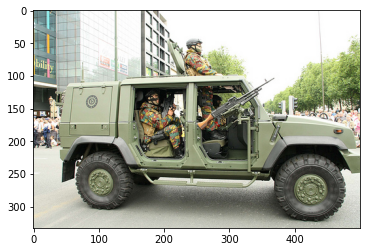

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


Final Eval Report with 35 Epochs

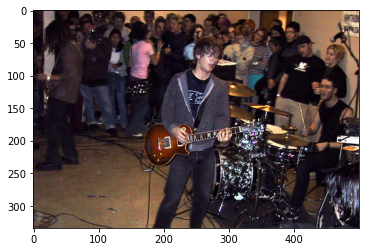

Real Caption: band plays with the guitar in front for crowd
Predicted Caption: group of people are gathered around fire
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


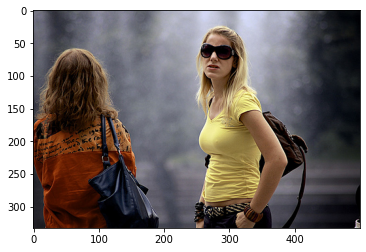

Real Caption: blond woman in yellow shirt standing by woman in an orange shirt
Predicted Caption: woman in black and white dress is standing in front of microphone
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


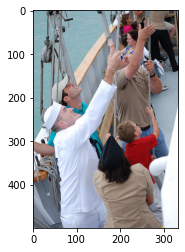

Real Caption: man in an aqua colored shirt sailor young boy wearing red shirt and some other people tug on ropes while standing on ship deck
Predicted Caption: group of people are sitting on bench
BLEU-1 score: 2.5189339817816414
BLEU-2 score: 7.029477144195254e-154
BLEU-3 score: 1.5504975174276478e-184
BLEU-4 score: 1.1742921079512431e-230


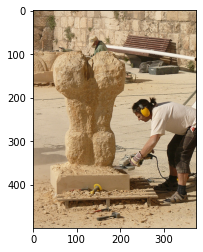

Real Caption: man is wearing yellow protective headphones while using circular saw to carve pieces away from tan stone sculpture
Predicted Caption: man in white shirt and black pants is playing with his arms in the air
BLEU-1 score: 10.916410041039759
BLEU-2 score: 4.4594642597023906e-153
BLEU-3 score: 1.1455904470567856e-183
BLEU-4 score: 9.013305912816874e-230


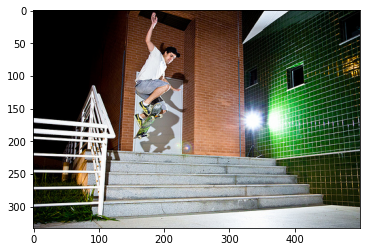

Real Caption: man in shorts and is skateboarding in midair down concrete stairs
Predicted Caption: man in black shirt and black pants is jumping off of the stairs
BLEU-1 score: 38.46153846153847
BLEU-2 score: 17.90287185098582
BLEU-3 score: 1.8028390283166976e-91
BLEU-4 score: 6.311514251575016e-153


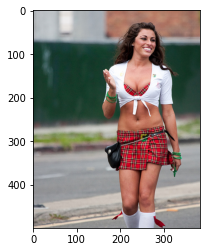

Real Caption: tilted kilt girl walking the street
Predicted Caption: woman in black and white dress is walking down the street
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


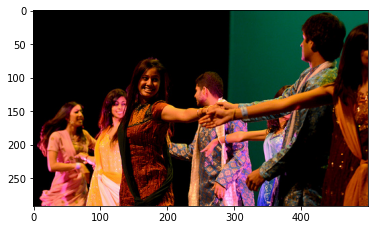

Real Caption: group of young women and men in exotic costumes perform dance
Predicted Caption: two girls in costumes are performing dance
BLEU-1 score: 24.202205228903967
BLEU-2 score: 5.51461944293045e-153
BLEU-3 score: 1.1216189750495802e-183
BLEU-4 score: 8.324264127738904e-230


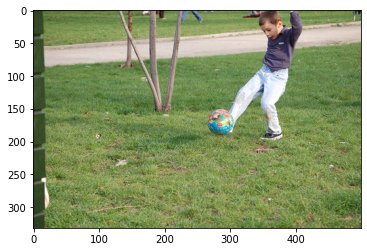

Real Caption: little boy kicking rubber ball
Predicted Caption: girl in blue shirt is jumping in the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


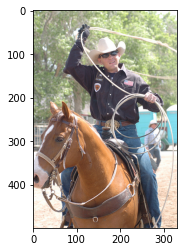

Real Caption: cowboy on horse is about to lasso something
Predicted Caption: man in cowboy hat is holding on to horse
BLEU-1 score: 55.55555555555556
BLEU-2 score: 1.1118237916213198e-152
BLEU-3 score: 2.14696471686284e-183
BLEU-4 score: 1.5728604687011317e-229


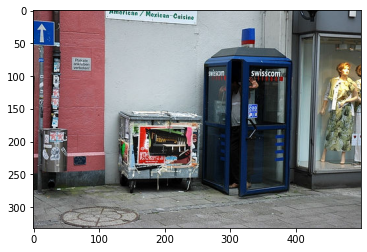

Real Caption: african american man with shopping bag standing in blue phone booth
Predicted Caption: woman in black shirt is standing outside of an apartment building
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


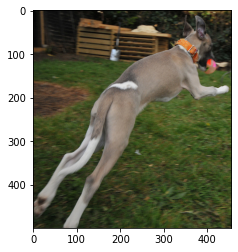

Real Caption: brown dog wearing an orange collar leaping to catch bright colored ball
Predicted Caption: black and white dog is playing with tennis ball
BLEU-1 score: 15.922918012750872
BLEU-2 score: 5.038498475779542e-153
BLEU-3 score: 1.168632815958936e-183
BLEU-4 score: 8.962731118674859e-230


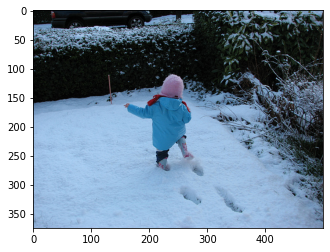

Real Caption: little girl in blue coat and pink hat makes tracks in the snow
Predicted Caption: young boy in blue snowsuit and blue pants is playing in the snow
BLEU-1 score: 46.15384615384615
BLEU-2 score: 33.96831102433788
BLEU-3 score: 25.481592515076173
BLEU-4 score: 3.908633169762327e-76


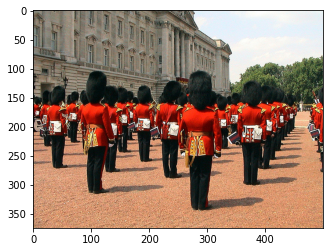

Real Caption: group of soldiers wearing big fuzzy black hats are standing in rows
Predicted Caption: group of people in bright orange vests and black pants are standing in front of an old building
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.253562503633297
BLEU-3 score: 18.604985196020532
BLEU-4 score: 3.0074186032008e-76


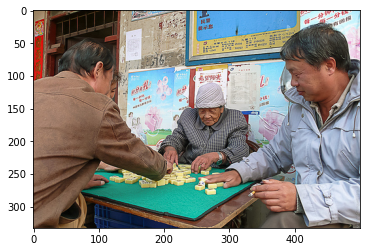

Real Caption: some older people are playing an ancient game
Predicted Caption: man in blue shirt is reading book while woman in white shirt is reading book
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


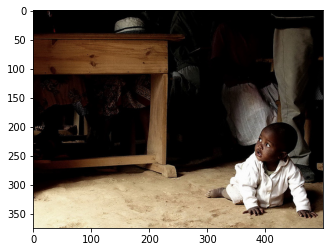

Real Caption: black baby is looking to his right
Predicted Caption: young boy in white shirt and blue pants is playing with an adult
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


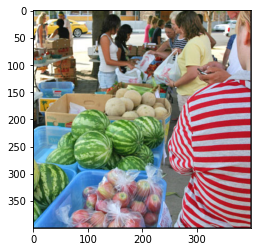

Real Caption: shoppers at an open air market bag fruits and vegetables there are bins of <unk> <unk> and apples in the foreground
Predicted Caption: group of people are gathered around fruit stand
BLEU-1 score: 4.922791880104851
BLEU-2 score: 1.4686343676243235e-153
BLEU-3 score: 3.327056134155667e-184
BLEU-4 score: 2.536674788921588e-230


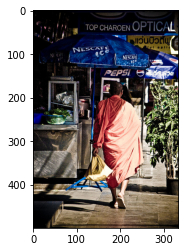

Real Caption: person in <unk> walks toward several blue outdoor umbrellas while carrying tan bag
Predicted Caption: man in blue shirt and black pants is standing in front of an open air market
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


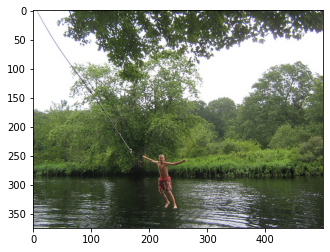

Real Caption: the man is dropping from swinging rope into calm river
Predicted Caption: man in red shirt is jumping into the water
BLEU-1 score: 39.77063630286087
BLEU-2 score: 8.898688699301466e-153
BLEU-3 score: 1.7967885069168788e-183
BLEU-4 score: 1.3310910140277609e-229


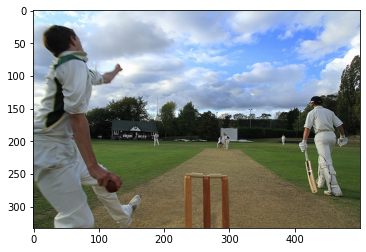

Real Caption: six men dressed in white clothing seem to be playing baseball on field with green grass on both sides
Predicted Caption: man in white shirt and black pants is jumping in the grass
BLEU-1 score: 13.950878644251178
BLEU-2 score: 8.41269635613876
BLEU-3 score: 9.074633178683692e-92
BLEU-4 score: 3.2319943940145725e-153


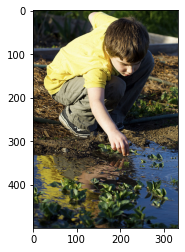

Real Caption: little boy <unk> plants growing in puddle of water
Predicted Caption: young boy in blue shirt and shorts is playing with his hands
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


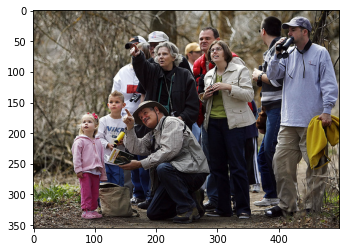

Real Caption: forest guide points something up to group of visitors
Predicted Caption: group of people are sitting on the grass in the park
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


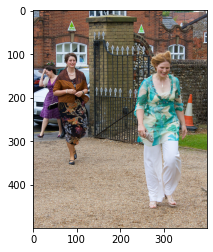

Real Caption: woman in white pants and floral top woman in dress with brown jacket and another woman in purple dress all <unk> somewhere as the wind blows
Predicted Caption: woman in blue shirt and black pants is walking down the street
BLEU-1 score: 12.975134329774907
BLEU-2 score: 6.060677025650216
BLEU-3 score: 5.902625854866919e-92
BLEU-4 score: 2.0492471437353754e-153


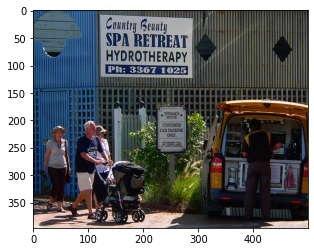

Real Caption: an older man wearing shorts and pushes baby stroller as he walks in front of two women wearing hats
Predicted Caption: man in blue shirt and woman in black shirt are sitting on bench
BLEU-1 score: 14.545688921462768
BLEU-2 score: 4.5166616683104505e-153
BLEU-3 score: 1.039720058462003e-183
BLEU-4 score: 7.959012597992964e-230


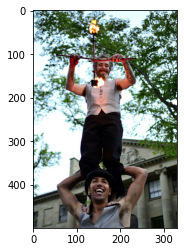

Real Caption: smiling man holding sticks and fire stands on the shoulders of another smiling man
Predicted Caption: young boy in blue shirt and black pants is jumping in the air
BLEU-1 score: 14.245555056035633
BLEU-2 score: 5.417616629968933e-153
BLEU-3 score: 1.3524629728545973e-183
BLEU-4 score: 1.0565078215140204e-229


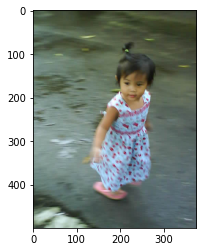

Real Caption: young asian girl wearing and flowered sundress runs down the street
Predicted Caption: little girl in pink and white striped shirt is running in the grass
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


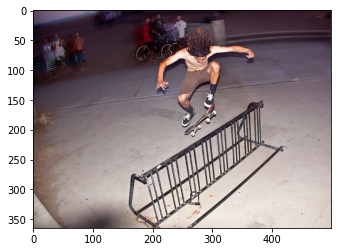

Real Caption: skateboarder jumping over bike rack in city
Predicted Caption: man in black shirt and black pants is jumping on trampoline
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


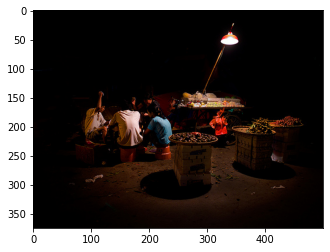

Real Caption: group of people sitting around playing cards
Predicted Caption: group of people are gathered around fire
BLEU-1 score: 57.14285714285714
BLEU-2 score: 43.643578047198474
BLEU-3 score: 37.519859868268625
BLEU-4 score: 5.395774370246973e-76


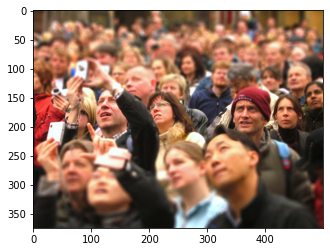

Real Caption: crowd of people stare up and take photos of something
Predicted Caption: group of people are gathered together in the street
BLEU-1 score: 19.885318151430436
BLEU-2 score: 14.91398861357283
BLEU-3 score: 1.5454595293390365e-91
BLEU-4 score: 5.449311673289858e-153


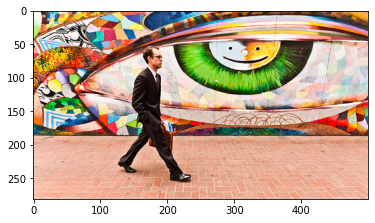

Real Caption: man in black suit passing by festive mural
Predicted Caption: man in black shirt is standing on the street
BLEU-1 score: 33.33333333333333
BLEU-2 score: 28.867513459481287
BLEU-3 score: 26.467700653516886
BLEU-4 score: 4.034282314146679e-76


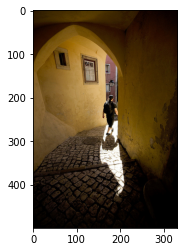

Real Caption: person in black clothing wearing backpack is walking down cobblestone pathway
Predicted Caption: man in black shirt and black pants is standing on the floor
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


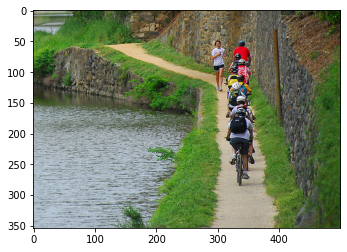

Real Caption: the seven boy are biking beside the lake
Predicted Caption: man in red shirt and black pants is walking down dirt path
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


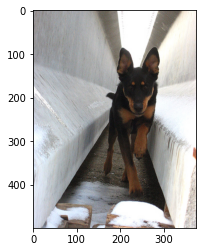

Real Caption: black and brown dog is running between two cement barriers with snow
Predicted Caption: black dog is jumping in the air
BLEU-1 score: 20.980356838155135
BLEU-2 score: 13.083551190106055
BLEU-3 score: 1.1224178752497289e-91
BLEU-4 score: 3.7751121892103357e-153


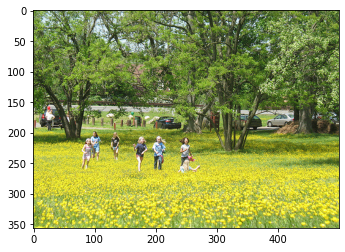

Real Caption: group of seven girls running through field of yellow flowers
Predicted Caption: two children playing in the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


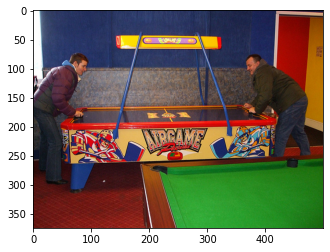

Real Caption: starting game of hair hockey between two men
Predicted Caption: man in blue shirt and black pants is playing pool
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


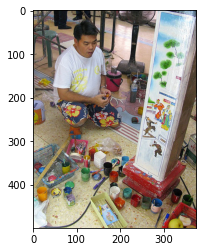

Real Caption: one guy in white shirt and colorful pants painting column with many bright and colorful paints
Predicted Caption: man in blue shirt is standing in front of vegetable market
BLEU-1 score: 11.54066216255058
BLEU-2 score: 4.0372374044186574e-153
BLEU-3 score: 9.747455682531433e-184
BLEU-4 score: 7.551114723170368e-230


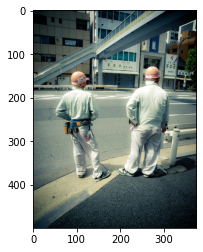

Real Caption: two construction workers wearing orange hard hats stand on the site of the highway
Predicted Caption: two men are sitting on the street in front of an old building
BLEU-1 score: 28.49111011207126
BLEU-2 score: 14.827243801836115
BLEU-3 score: 1.561265199697373e-91
BLEU-4 score: 5.527118757926412e-153


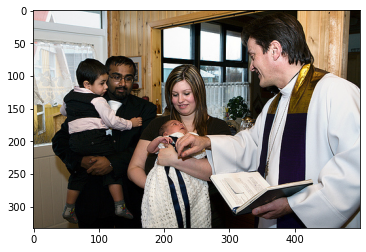

Real Caption: woman holds baby while man looks at it as another man holding child watches
Predicted Caption: man in black shirt and woman in white shirt are talking
BLEU-1 score: 13.84182521267043
BLEU-2 score: 4.842246805851196e-153
BLEU-3 score: 1.1691060350390872e-183
BLEU-4 score: 9.056777564992551e-230


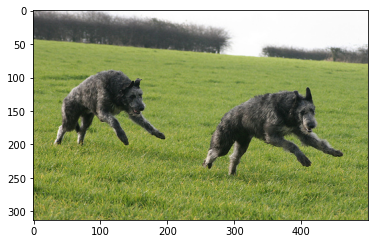

Real Caption: two gray dogs run together over the green grass
Predicted Caption: two dogs playing in the grass
BLEU-1 score: 40.43537731417556
BLEU-2 score: 7.387191291385562e-153
BLEU-3 score: 1.375409564845428e-183
BLEU-4 score: 9.98477465632745e-230


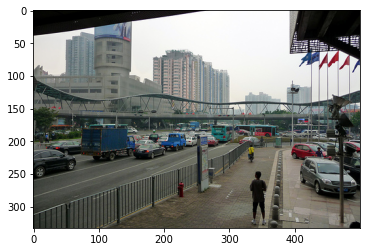

Real Caption: cars line up in very busy road in the middle of the city
Predicted Caption: man in blue shirt walks down the street
BLEU-1 score: 13.381535712974756
BLEU-2 score: 3.9921621141636406e-153
BLEU-3 score: 9.043876231738548e-184
BLEU-4 score: 6.895396983435736e-230


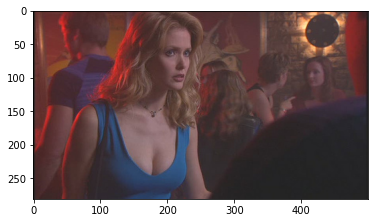

Real Caption: the woman is talking to someone
Predicted Caption: woman in black shirt is holding microphone
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


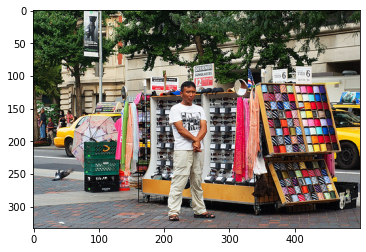

Real Caption: man with white shirt standing next to vending stall
Predicted Caption: two men in costumes are standing in front of an open <unk> <unk> <unk>
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


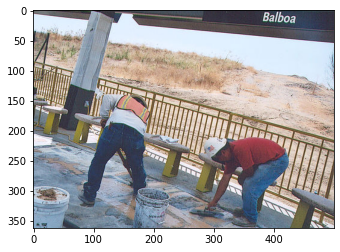

Real Caption: two construction workers smooth out concrete surface
Predicted Caption: man in blue shirt and blue jeans is standing next to man in blue shirt
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


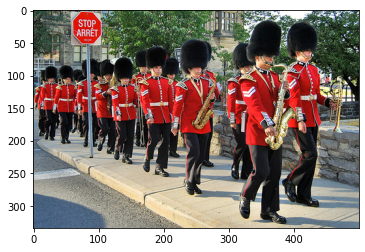

Real Caption: military marching band of soldiers in formal uniform with red coats and fuzzy black hats march by led by the <unk>
Predicted Caption: group of people in bright orange vests are standing in front of an outdoor building
BLEU-1 score: 8.937600613808524
BLEU-2 score: 3.651100531670483e-153
BLEU-3 score: 9.379301294377439e-184
BLEU-4 score: 7.379470737722785e-230


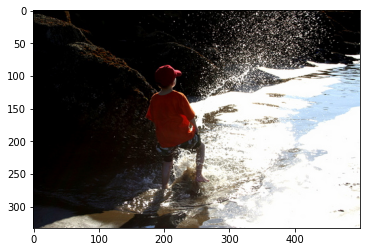

Real Caption: young boy makes splash in the water near the rocks
Predicted Caption: man in red shirt is standing in the snow
BLEU-1 score: 19.885318151430436
BLEU-2 score: 14.91398861357283
BLEU-3 score: 1.5454595293390365e-91
BLEU-4 score: 5.449311673289858e-153


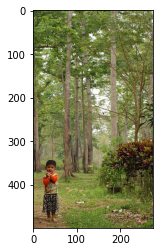

Real Caption: little boy is standing alone in wooded park
Predicted Caption: young boy in red shirt and black pants is standing in the grass
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153


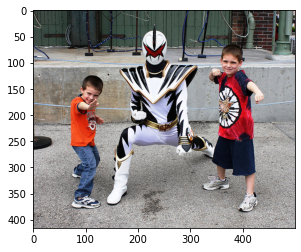

Real Caption: two boys are posing along with an adult in costume
Predicted Caption: two girls are playing with an animal
BLEU-1 score: 37.225089001774606
BLEU-2 score: 20.10384577463796
BLEU-3 score: 1.6282471743409526e-91
BLEU-4 score: 5.398196439422726e-153


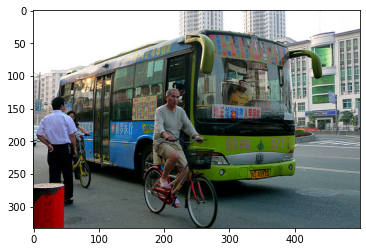

Real Caption: man is riding bicycle near bus
Predicted Caption: man in blue shirt and woman in white shirt are riding bike down the street
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229


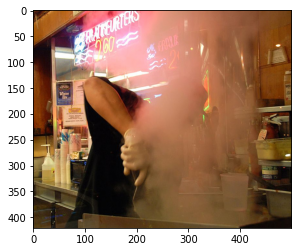

Real Caption: <unk> works over large steaming pot
Predicted Caption: man in white shirt is cooking in kitchen
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


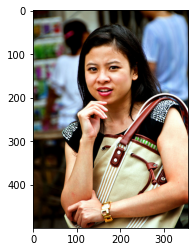

Real Caption: woman of <unk> holds her right hand to her chin and looks at the camera while she holds her purse to her chest with her other arm
Predicted Caption: woman in black shirt is holding drink
BLEU-1 score: 0.8204659895373907
BLEU-2 score: 3.238037088306951e-154
BLEU-3 score: 8.204193029744317e-185
BLEU-4 score: 6.432687245300671e-231


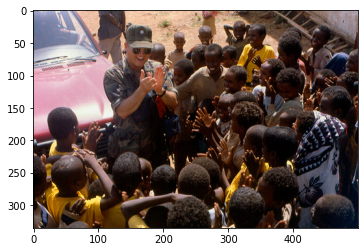

Real Caption: group of black children huddled around white soldier they are all clapping
Predicted Caption: group of people are gathered around fire
BLEU-1 score: 27.973809117540178
BLEU-2 score: 15.10758360312796
BLEU-3 score: 1.2235907790312224e-91
BLEU-4 score: 4.056622047786037e-153


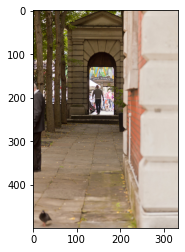

Real Caption: man is walking through an older archway
Predicted Caption: man in black shirt is standing in front of an old building
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


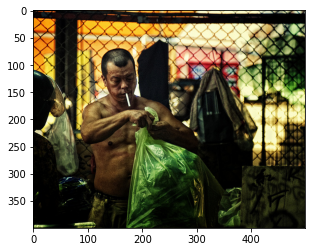

Real Caption: man with cigarette in his mouth is tying green trash bag
Predicted Caption: man in black shirt and black pants is holding up an open air balloon
BLEU-1 score: 21.428571428571423
BLEU-2 score: 6.905081759897607e-153
BLEU-3 score: 1.6132609611386312e-183
BLEU-4 score: 1.239528818333946e-229


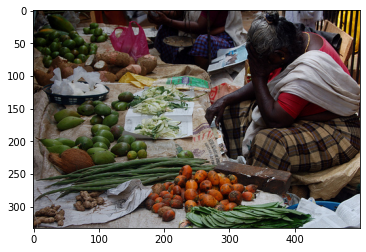

Real Caption: woman in india selling her fruits and vegetables
Predicted Caption: man in blue shirt is standing in front of vegetable market vendor
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


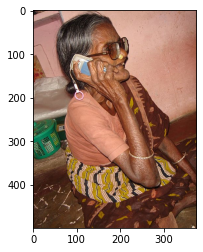

Real Caption: an elderly woman with glasses takes call on cellular phone
Predicted Caption: woman in black and white dress is holding flowers
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230


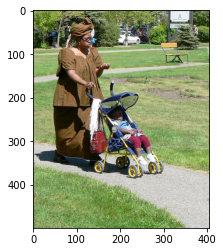

Real Caption: woman is walking her baby with stroller at the local park
Predicted Caption: young girl in pink shirt and black pants is pushing cart
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


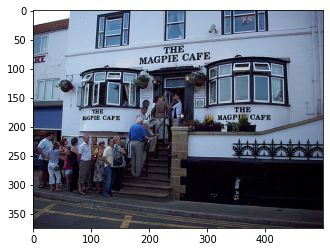

Real Caption: line of people waiting outside the <unk> cafe during the day
Predicted Caption: people are walking down the street in front of an advertisement
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


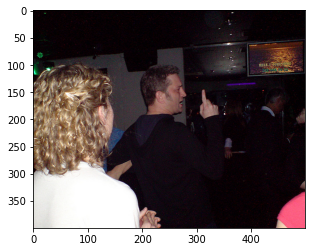

Real Caption: woman in white shirt is looking at man in black shirt pointing upwards
Predicted Caption: man in black shirt is talking to man in black shirt
BLEU-1 score: 53.05700387751149
BLEU-2 score: 42.064917357437594
BLEU-3 score: 35.221124429966395
BLEU-4 score: 24.177037175577336


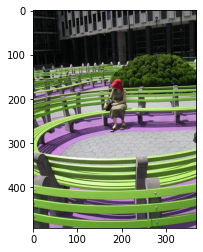

Real Caption: woman sitting alone very long green bench
Predicted Caption: woman in red shirt and black pants is sitting on bench
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


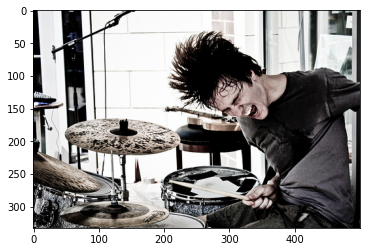

Real Caption: man in gray shirt rocking out on the drums
Predicted Caption: man in black shirt and black pants is playing the drums
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 2.4648217855445784e-91
BLEU-4 score: 8.190757052088229e-153


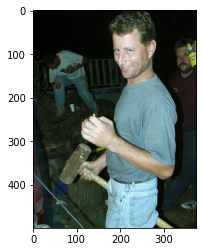

Real Caption: smiling man holding cigarette in one hand and sledgehammer in the other
Predicted Caption: man in blue shirt is holding up
BLEU-1 score: 20.980356838155135
BLEU-2 score: 4.780501720609066e-153
BLEU-3 score: 9.723067014109315e-184
BLEU-4 score: 7.2161206040200775e-230


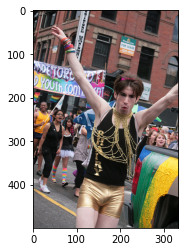

Real Caption: guy in gold chains black top and gold shorts is walking with his arms outstretched in parade
Predicted Caption: man in red shirt is holding up his hands
BLEU-1 score: 13.703743016906248
BLEU-2 score: 3.540560736426082e-153
BLEU-3 score: 7.572351111919078e-184
BLEU-4 score: 5.690998490426158e-230


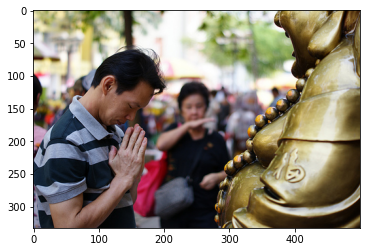

Real Caption: man is praying to an <unk>
Predicted Caption: man in black shirt and black pants is holding up his hands
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


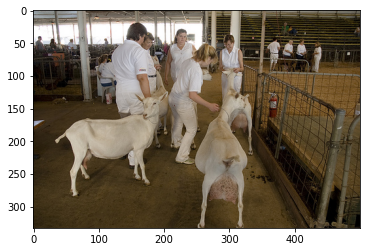

Real Caption: people dressed in all white are looking at some shaved <unk>
Predicted Caption: group of people are gathered around an outdoor fountain
BLEU-1 score: 17.794164509262398
BLEU-2 score: 5.630618124510453e-153
BLEU-3 score: 1.3059694561916118e-183
BLEU-4 score: 1.0016022933125248e-229


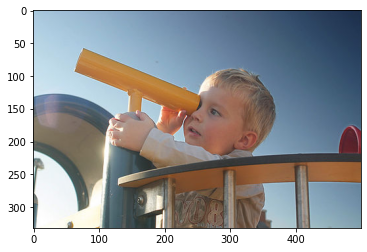

Real Caption: little boy looking through telescope on playground equipment with the sun <unk> off the pole his hand is on
Predicted Caption: young boy is looking at the camera
BLEU-1 score: 10.290989265597277
BLEU-2 score: 2.0307121405581533e-153
BLEU-3 score: 3.8993338344561103e-184
BLEU-4 score: 2.852620410550774e-230


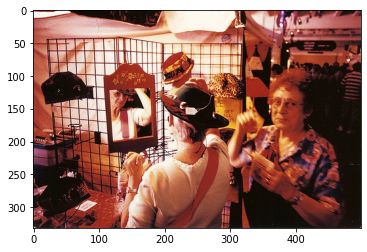

Real Caption: an older woman in white shirt is trying on hat while glancing in the mirror while another older woman in loud print shirt looks on
Predicted Caption: man in black shirt and woman in black and white dress are dancing
BLEU-1 score: 15.280565892219663
BLEU-2 score: 7.11271633745279
BLEU-3 score: 7.162584146967229e-92
BLEU-4 score: 2.5075312444227636e-153


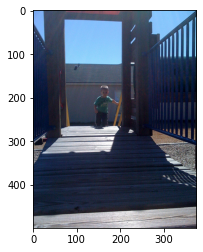

Real Caption: little boy climbing up the steps to bridge on playground
Predicted Caption: woman in black shirt and black pants is walking down the street
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


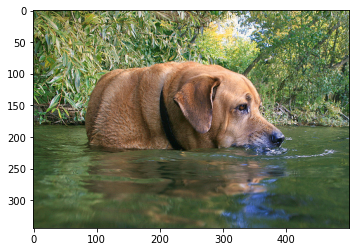

Real Caption: the brown dog is taking drink while wading in the water
Predicted Caption: brown dog is playing in the water
BLEU-1 score: 48.404410457807934
BLEU-2 score: 42.68867747668464
BLEU-3 score: 36.269227650246485
BLEU-4 score: 4.768956028937764e-76


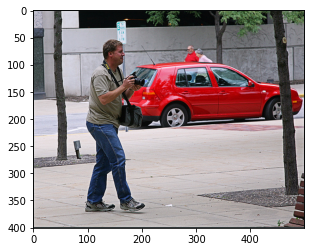

Real Caption: man close to red car is taking pictures
Predicted Caption: man in black shirt and black pants is walking down the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


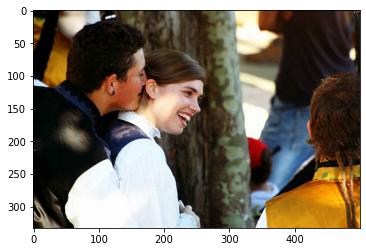

Real Caption: man kisses the neck of woman sitting on his lap
Predicted Caption: man in black shirt and woman in black shirt are kissing
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


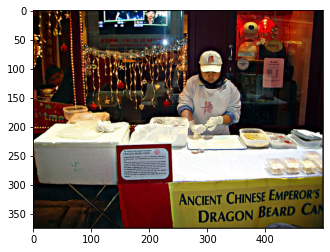

Real Caption: chinese restaurant employee giving food workshop
Predicted Caption: man in white shirt is standing at podium
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


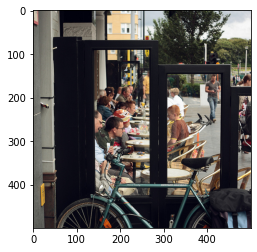

Real Caption: people eating outside at an eatery
Predicted Caption: man in white shirt and woman in black shirt are riding bike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


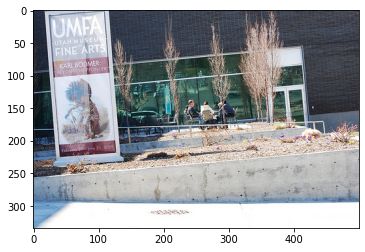

Real Caption: people having coffee outside of museum
Predicted Caption: man in blue shirt is sitting on the steps outside of building
BLEU-1 score: 16.666666666666668
BLEU-2 score: 12.309149097933275
BLEU-3 score: 1.4399259176082162e-91
BLEU-4 score: 5.233427736988301e-153


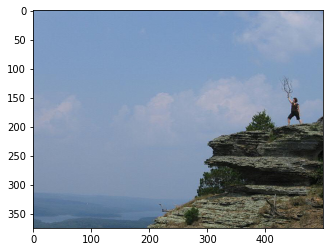

Real Caption: woman holding branch on top cliff
Predicted Caption: man is standing on top of mountain
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


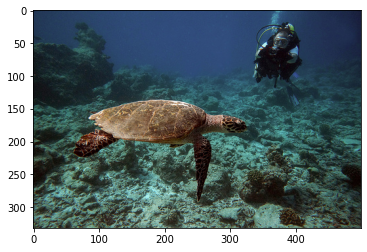

Real Caption: sea turtle is swimming along and scuba diver is filming it in the background
Predicted Caption: man in blue and white swimming trunks is in the water
BLEU-1 score: 34.60456303167608
BLEU-2 score: 16.230978780557674
BLEU-3 score: 1.524167074255524e-91
BLEU-4 score: 5.243515980040811e-153


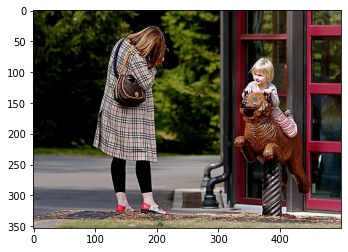

Real Caption: woman stands next to child who is riding on toy
Predicted Caption: woman in black and white striped shirt is walking down the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


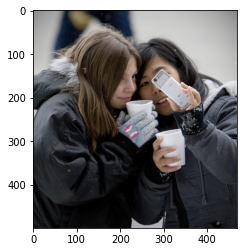

Real Caption: two women dressed for cold weather in jackets and gloves look at something on cellphone screen
Predicted Caption: woman in black shirt is holding baby
BLEU-1 score: 3.949329237565206
BLEU-2 score: 1.5586355447081413e-153
BLEU-3 score: 3.949104510872758e-184
BLEU-4 score: 3.0963867043779474e-230


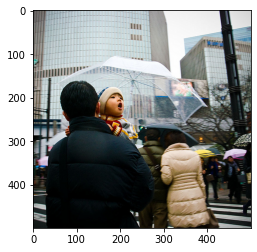

Real Caption: child <unk> new world
Predicted Caption: man in blue shirt and woman in black shirt are standing on the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


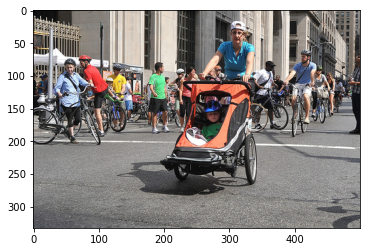

Real Caption: lot of bike riders must be relay race
Predicted Caption: man in blue shirt is riding bike down the street
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


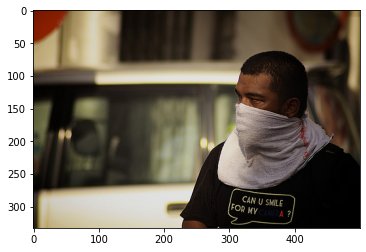

Real Caption: man in black graphic wearing white towel across the bottom portion of his face
Predicted Caption: man in blue shirt is standing in front of an open window
BLEU-1 score: 21.162043122265352
BLEU-2 score: 12.76119215161368
BLEU-3 score: 1.376528199714348e-91
BLEU-4 score: 4.90260194222537e-153


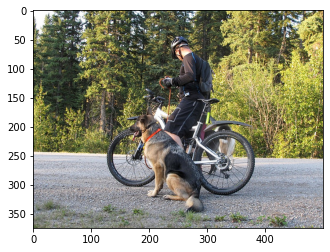

Real Caption: man on bike with dog on leash
Predicted Caption: man rides bike down dirt path
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229


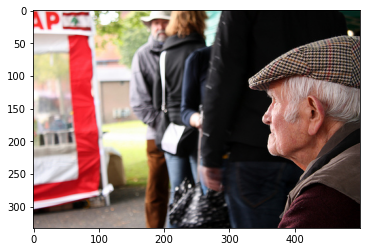

Real Caption: this is profile shot of an old man in newspaper boy hat with people blurred out in the background
Predicted Caption: man in black shirt is holding an umbrella
BLEU-1 score: 12.641979790237324
BLEU-2 score: 6.757422437941194
BLEU-3 score: 5.797089509379079e-92
BLEU-4 score: 1.9497785763551893e-153


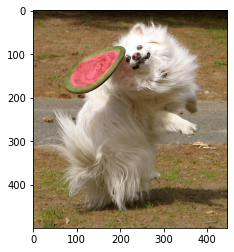

Real Caption: white dog with long hair jumps to catch red and green toy
Predicted Caption: dog runs on the street
BLEU-1 score: 4.93193927883213
BLEU-2 score: 1.6450342287110981e-153
BLEU-3 score: 3.8967575262557506e-184
BLEU-4 score: 3.0043709069803197e-230


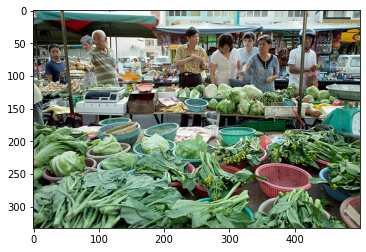

Real Caption: group of people look at fresh <unk> in at the local street market
Predicted Caption: group of people are sitting at fruit market
BLEU-1 score: 33.453839282436896
BLEU-2 score: 22.618923685244415
BLEU-3 score: 18.649370010050887
BLEU-4 score: 2.7152963593503125e-76


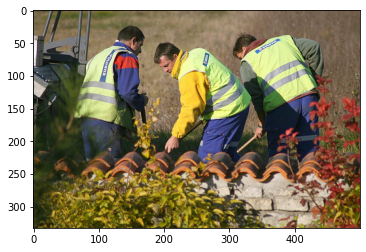

Real Caption: three construction workers are digging whole next to wall in field
Predicted Caption: group of people in the park
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230


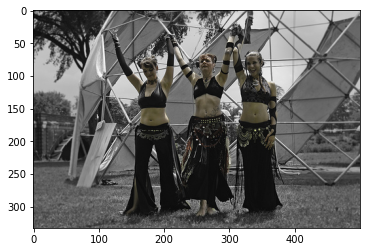

Real Caption: three females in belly dancing outfits raise their arms at <unk> of an activity
Predicted Caption: group of people in the park
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230


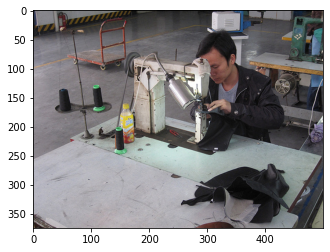

Real Caption: guy working in factory
Predicted Caption: woman in black shirt is playing the violin
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


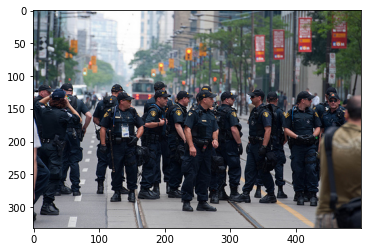

Real Caption: crowd of law enforcement officers who are all in uniform are blocking off street in crowded neighborhood
Predicted Caption: group of people are gathered outside in the street
BLEU-1 score: 18.271657355874996
BLEU-2 score: 4.0882873885157646e-153
BLEU-3 score: 8.254910404085694e-184
BLEU-4 score: 6.115375859865212e-230


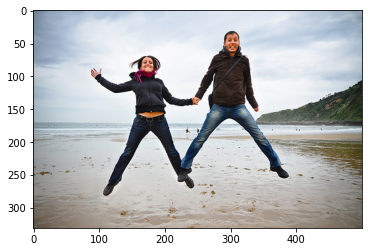

Real Caption: man and woman are jumping in the air on wet sand at the beach
Predicted Caption: man in black and white shirt is jumping in the air on the beach
BLEU-1 score: 64.28571428571429
BLEU-2 score: 49.72451580988469
BLEU-3 score: 43.383475443818206
BLEU-4 score: 32.55964126200301


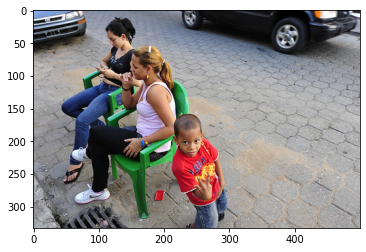

Real Caption: two women sit in chairs while child in the street gets the attention of the camera
Predicted Caption: two girls are sitting on the street
BLEU-1 score: 11.847987712695618
BLEU-2 score: 7.3885184572690745
BLEU-3 score: 6.338497146189663e-92
BLEU-4 score: 2.131874265859462e-153


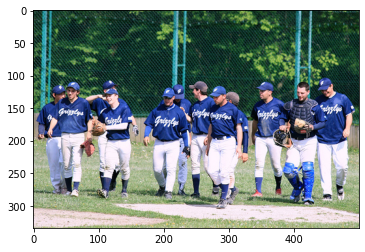

Real Caption: group of baseball players wearing blue uniforms walk across the grass
Predicted Caption: group of people are playing soccer in the park
BLEU-1 score: 26.691246763893595
BLEU-2 score: 16.34498379256302
BLEU-3 score: 1.5618167350796274e-91
BLEU-4 score: 5.396466934950335e-153


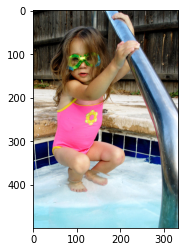

Real Caption: little girl gets in to pool
Predicted Caption: girl in pink and white swimming goggles is jumping into pool
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


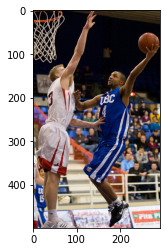

Real Caption: two men one with ball and blue uniform and the other in white uniform are playing basketball
Predicted Caption: basketball player in white jersey is about to hit the ball
BLEU-1 score: 26.344467217491342
BLEU-2 score: 12.35665042210731
BLEU-3 score: 1.1603489830213731e-91
BLEU-4 score: 3.991890743256307e-153


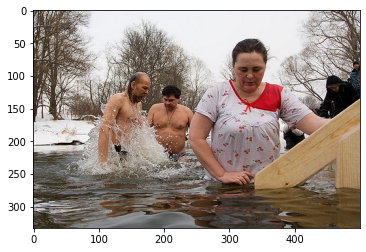

Real Caption: family in cold pool of water in the winter
Predicted Caption: two girls in bathing suits are playing in the water
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153


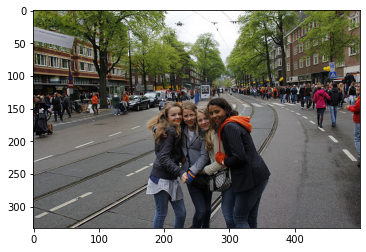

Real Caption: four girls standing together in the street posing for picture
Predicted Caption: two women are walking down the street
BLEU-1 score: 18.612544500887303
BLEU-2 score: 14.215565675175021
BLEU-3 score: 1.3225476692186996e-91
BLEU-4 score: 4.539324034745998e-153


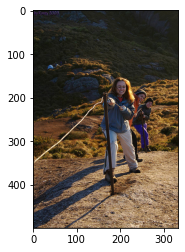

Real Caption: group of people pulling on rope
Predicted Caption: man in blue shirt and woman in black shirt are standing on the grass
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


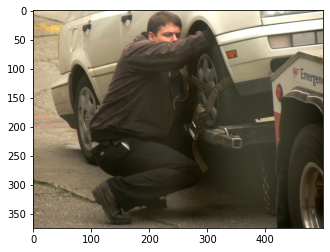

Real Caption: man in brown jacket has his hand in the of white car in tow
Predicted Caption: man in blue shirt is standing in the street
BLEU-1 score: 25.500152032774785
BLEU-2 score: 19.125114024581094
BLEU-3 score: 1.5019513460043838e-91
BLEU-4 score: 4.941250555528194e-153


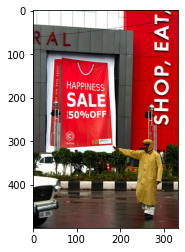

Real Caption: person in raincoat pointing to sales sign
Predicted Caption: man in blue shirt is standing in front of an advertisement
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


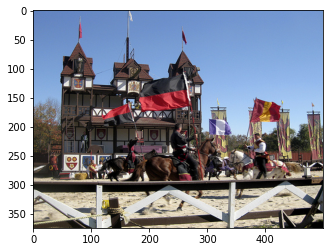

Real Caption: several <unk> are riding past each other carrying flags
Predicted Caption: group of people are gathered outside of an outdoor building
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


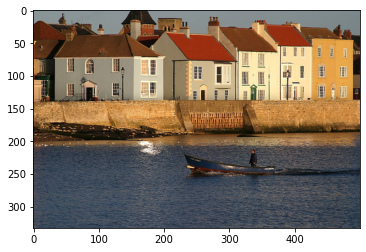

Real Caption: man driving blue boat passes by some colorful houses
Predicted Caption: man in red shirt is sitting on the edge of the water
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


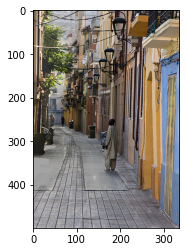

Real Caption: man in long white shirt stands in the street
Predicted Caption: man in blue shirt walks down the street
BLEU-1 score: 55.156056411537215
BLEU-2 score: 37.292300600205394
BLEU-3 score: 2.663545445210579e-91
BLEU-4 score: 8.557332335294228e-153


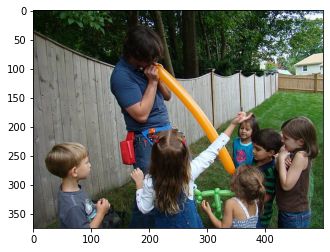

Real Caption: man is making balloon animals for group of young children
Predicted Caption: group of people are sitting in the grass
BLEU-1 score: 19.470019576785123
BLEU-2 score: 14.717951377637847
BLEU-3 score: 1.4503816601791856e-91
BLEU-4 score: 5.050205928624139e-153


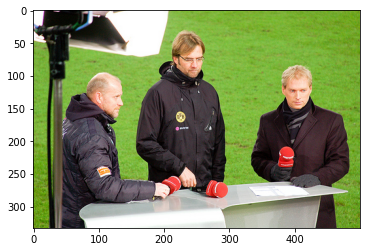

Real Caption: three men in black jackets stand by desk in field holding red microphones
Predicted Caption: man in black shirt and black pants is playing the piano
BLEU-1 score: 15.159143965003283
BLEU-2 score: 11.242322053892272
BLEU-3 score: 1.2680368934583593e-91
BLEU-4 score: 4.566872745130659e-153


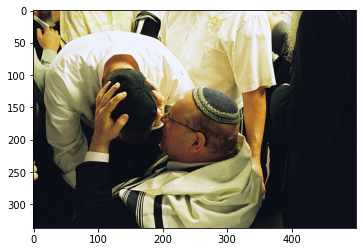

Real Caption: jewish man is holding the head of another man who has bent down toward him
Predicted Caption: two men are standing in front of an outdoor statue
BLEU-1 score: 6.065306597126336
BLEU-2 score: 2.8610468846784813e-153
BLEU-3 score: 7.785014358277125e-184
BLEU-4 score: 6.213854539426459e-230


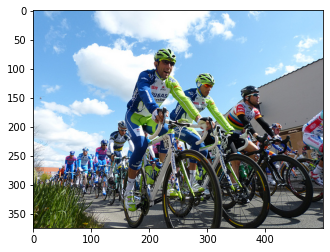

Real Caption: bicycle riders riding in group at professional race
Predicted Caption: group of people are riding bikes in the street
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


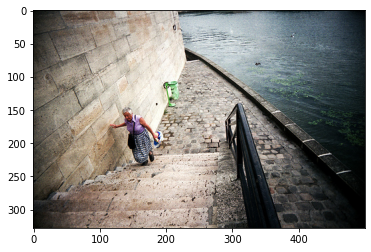

Real Caption: female is walking up <unk> of steps with water to her left
Predicted Caption: woman in black shirt and black pants walks down the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


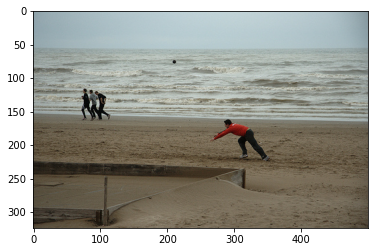

Real Caption: man in red shirt and black pants on beach
Predicted Caption: woman in red shirt and black pants walks on the beach
BLEU-1 score: 72.72727272727273
BLEU-2 score: 60.30226891555272
BLEU-3 score: 57.88225423006262
BLEU-4 score: 49.616830003403635


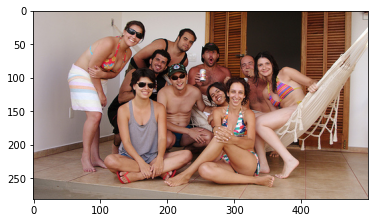

Real Caption: group of friends sit together for picture in their bathing suits
Predicted Caption: group of children are sitting on the floor
BLEU-1 score: 17.182231969774307
BLEU-2 score: 12.988546503156082
BLEU-3 score: 1.2799573226736345e-91
BLEU-4 score: 4.456791089425162e-153


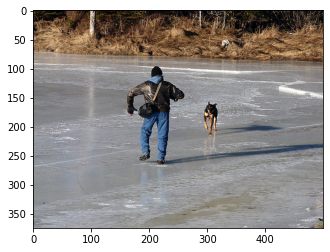

Real Caption: man and dog running across shallow water on beach
Predicted Caption: man and woman are walking down the street
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153


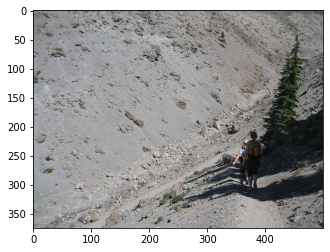

Real Caption: two hikers walk down an <unk> slope next to green <unk>
Predicted Caption: man is climbing up steep mountain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


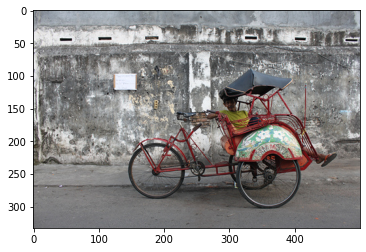

Real Caption: man in yellow shirt smiling sitting in red bike in the backseat
Predicted Caption: man in blue shirt and black pants is riding bike
BLEU-1 score: 32.749230123119276
BLEU-2 score: 17.260359801008903
BLEU-3 score: 1.6281322452445258e-91
BLEU-4 score: 5.607479438626032e-153


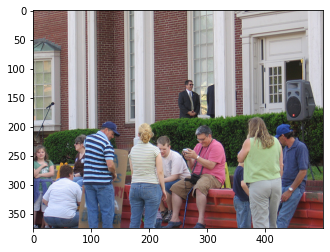

Real Caption: group of people gathered for meeting
Predicted Caption: group of people are gathered outside building
BLEU-1 score: 57.14285714285714
BLEU-2 score: 43.643578047198474
BLEU-3 score: 37.519859868268625
BLEU-4 score: 5.395774370246973e-76


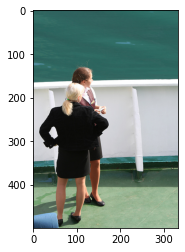

Real Caption: woman in black skirt suit is speaking with another woman in boat
Predicted Caption: man in black shirt and black pants is holding an infant
BLEU-1 score: 24.902746807698065
BLEU-2 score: 15.079362038065447
BLEU-3 score: 1.5683413167214647e-91
BLEU-4 score: 5.535069030704902e-153


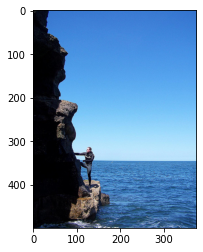

Real Caption: scuba diver stands on top of rocks after emerging from the water
Predicted Caption: man is standing on the edge of lake
BLEU-1 score: 22.744899739223754
BLEU-2 score: 5.540393468539137e-153
BLEU-3 score: 1.1573608787806806e-183
BLEU-4 score: 8.647068503442338e-230


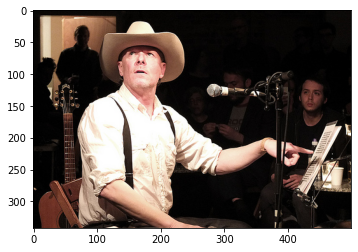

Real Caption: man in white cowboy hat is sitting in front of microphone and pointing at piece of paper
Predicted Caption: man in white shirt and black hat is holding microphone
BLEU-1 score: 34.760971265398666
BLEU-2 score: 23.987349079540827
BLEU-3 score: 17.19728553619981
BLEU-4 score: 2.5064074346000402e-76


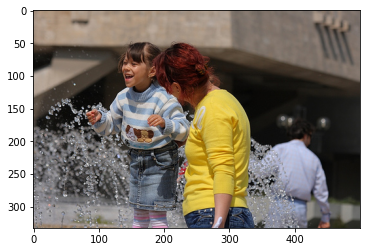

Real Caption: little girl and woman wearing yellow shirt get splashed by city fountain
Predicted Caption: two girls in bathing suits are playing in fountain
BLEU-1 score: 7.961459006375435
BLEU-2 score: 3.5627564392218957e-153
BLEU-3 score: 9.492248052231754e-184
BLEU-4 score: 7.536728468577135e-230


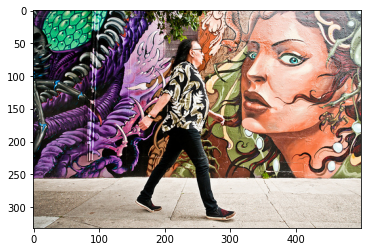

Real Caption: man in dark floral shirt and black jeans walks buy brightly colored wall painted with woman with bright green eyes
Predicted Caption: woman in black and white dress is walking down the street
BLEU-1 score: 16.044842463999416
BLEU-2 score: 3.968935306315731e-153
BLEU-3 score: 8.342092513909656e-184
BLEU-4 score: 6.242280805623045e-230


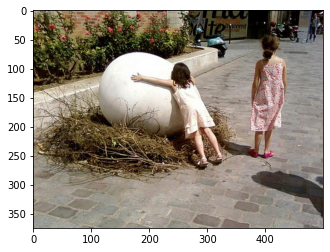

Real Caption: young girl hugging giant egg in the middle of busy town
Predicted Caption: young girl in white shirt and black pants is standing in the street
BLEU-1 score: 30.769230769230766
BLEU-2 score: 22.64554068289192
BLEU-3 score: 2.0758355536666792e-91
BLEU-4 score: 7.098450576376767e-153


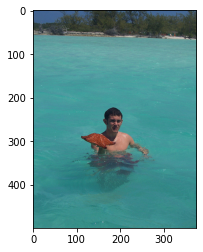

Real Caption: man holds up an orange <unk> while standing chest deep in the ocean
Predicted Caption: man in blue swimming trunks is swimming in the water
BLEU-1 score: 22.224546620451534
BLEU-2 score: 13.525428349273898
BLEU-3 score: 1.3513834888746436e-91
BLEU-4 score: 4.721756180471194e-153


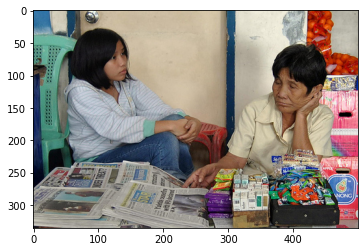

Real Caption: an old lady and her <unk> working in convenience store
Predicted Caption: two women are sitting at table eating
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


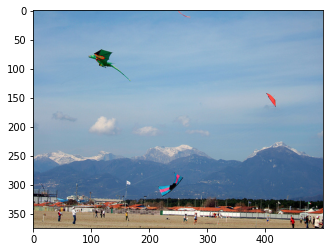

Real Caption: several people are flying kites with mountains in the background
Predicted Caption: snowboarder is jumping off of the side of the water
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


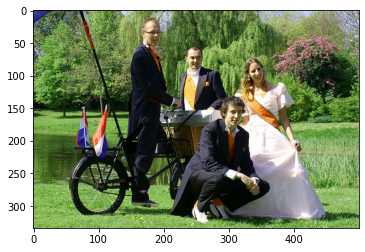

Real Caption: this is picture of three young men dressed in suits with one on bike and of young lady wearing white dress
Predicted Caption: man in blue shirt and woman in white shirt are riding bike
BLEU-1 score: 15.745551758033821
BLEU-2 score: 4.0680916344595085e-153
BLEU-3 score: 8.700604368867122e-184
BLEU-4 score: 6.538936929519805e-230


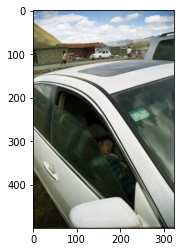

Real Caption: child is sleeping in the front passenger seat of car with the window slightly open
Predicted Caption: man in blue shirt is sitting in bus
BLEU-1 score: 10.42155049196271
BLEU-2 score: 3.1090989806586375e-153
BLEU-3 score: 7.043377891278847e-184
BLEU-4 score: 5.370140570287953e-230


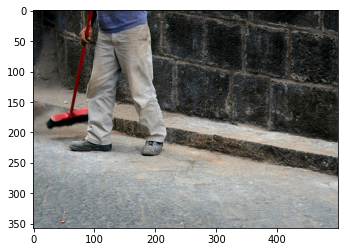

Real Caption: man sweeping the cement ground
Predicted Caption: man in blue shirt and black pants is sweeping the street
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


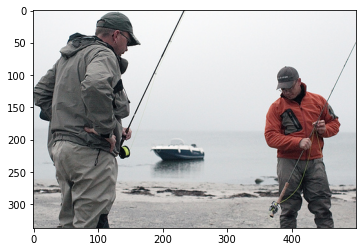

Real Caption: two men stand near the water with their fishing poles
Predicted Caption: man in blue shirt and black pants is standing in the snow
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


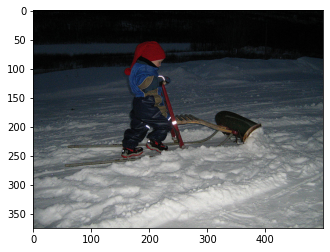

Real Caption: young child <unk> snow <unk>
Predicted Caption: young boy in red snowsuit and black pants is playing in the snow
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229


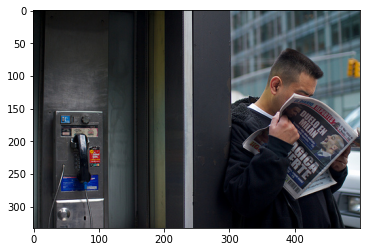

Real Caption: man with crew cut reading newspaper next to phone
Predicted Caption: man in black suit is talking on phone
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229


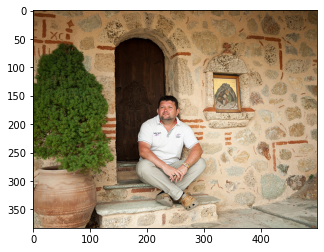

Real Caption: an hispanic man sitting on stoop
Predicted Caption: woman in blue shirt is sitting on the street
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153


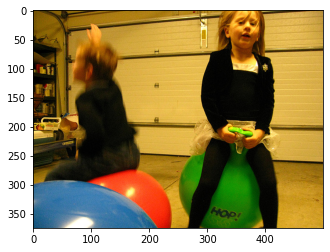

Real Caption: two children dressed in black bounce on red and green bouncy balls in garage
Predicted Caption: man in blue shirt is playing pool
BLEU-1 score: 5.255420588163462
BLEU-2 score: 2.0740953307181176e-153
BLEU-3 score: 5.255121541612728e-184
BLEU-4 score: 4.120399555529536e-230


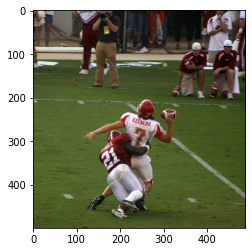

Real Caption: football player in red jersey is tackling football player in white jersey who is attempting to throw the ball
Predicted Caption: football player in white jersey is trying to tackle the player in white jersey
BLEU-1 score: 54.974270793760226
BLEU-2 score: 42.133845815787
BLEU-3 score: 34.05011591997083
BLEU-4 score: 25.07017090459915


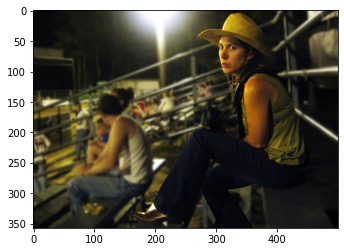

Real Caption: woman in cowboy hat sits in the stands
Predicted Caption: man in black shirt and black pants is talking to woman in black shirt
BLEU-1 score: 21.428571428571423
BLEU-2 score: 12.838814775327384
BLEU-3 score: 1.47678845808219e-91
BLEU-4 score: 5.344839673067705e-153


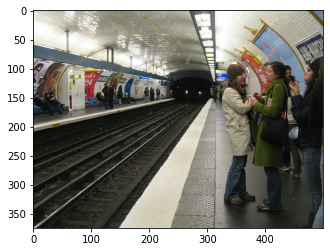

Real Caption: people stand on subway platform waiting for their train
Predicted Caption: two men are standing on the street in front of an airport
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


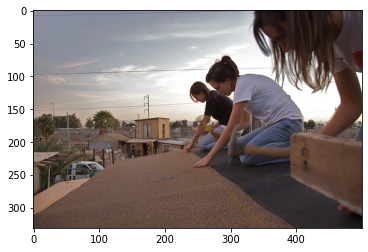

Real Caption: three girls hammer nails on roof
Predicted Caption: man in black shirt and black pants is jumping on trampoline
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


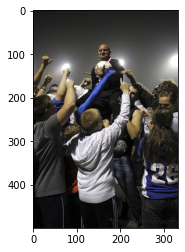

Real Caption: fans are cheering for an athlete wearing medal and holding ball
Predicted Caption: group of people are gathered together
BLEU-1 score: 7.243303475117973
BLEU-2 score: 2.646576928737885e-153
BLEU-3 score: 6.502033690529349e-184
BLEU-4 score: 5.058927350602078e-230


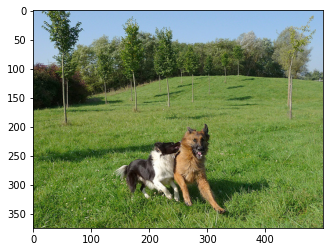

Real Caption: two dogs in motion in grassy field with small trees
Predicted Caption: two dogs playing in the grass
BLEU-1 score: 25.6708559516296
BLEU-2 score: 16.23567485864776
BLEU-3 score: 1.3021879578069072e-91
BLEU-4 score: 4.3066795795519947e-153


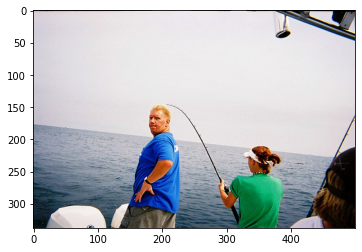

Real Caption: man poses looking back while younger girl fishes
Predicted Caption: man in blue shirt and blue pants is standing on boat in the water
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


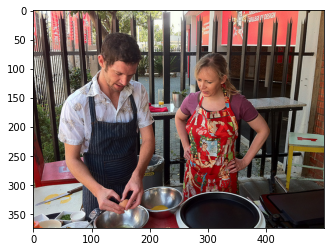

Real Caption: woman in red apron watches as man in black apron <unk> eggs
Predicted Caption: two women are cooking in kitchen
BLEU-1 score: 6.1313240195240395
BLEU-2 score: 2.2402790036937483e-153
BLEU-3 score: 5.503852693656168e-184
BLEU-4 score: 4.282289549833951e-230


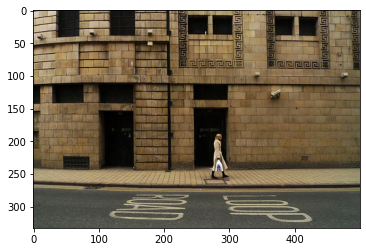

Real Caption: young woman in trench coat carries plastic bag down the sidewalk
Predicted Caption: man in blue shirt walks down the street
BLEU-1 score: 25.773347954661457
BLEU-2 score: 15.90765571657157
BLEU-3 score: 1.445515879877037e-91
BLEU-4 score: 4.932250118548181e-153


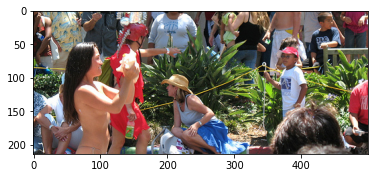

Real Caption: topless woman is holding <unk> <unk> while crowd looks at her
Predicted Caption: group of people in costumes are gathered outside
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


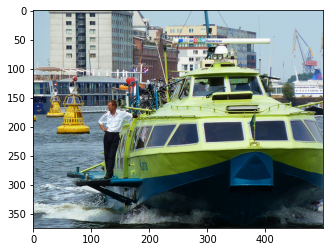

Real Caption: man stands on the side of green and blue boat
Predicted Caption: two men in hard hats are standing in the water
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


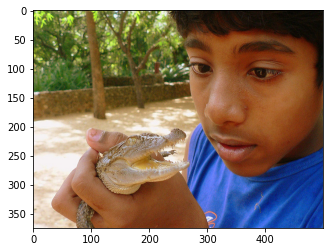

Real Caption: young boy holds baby crocodile up to the camera
Predicted Caption: man in blue shirt is holding baby
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


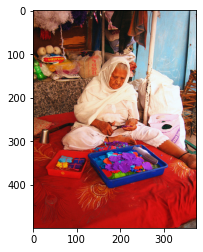

Real Caption: old woman in white cutting colorful craft like sheets
Predicted Caption: little girl in pink shirt is sitting on the floor
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


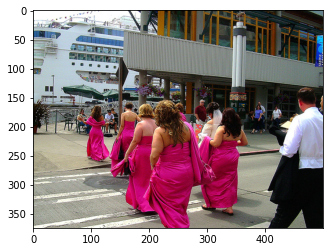

Real Caption: group of woman in pink dresses walking across crosswalk towards <unk>
Predicted Caption: two women in red and black outfits are walking down the street
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


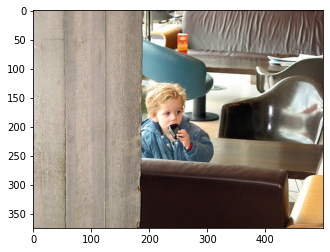

Real Caption: young child tries to put cellphone in his mouth
Predicted Caption: young boy in blue shirt and jeans is sitting on bed
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


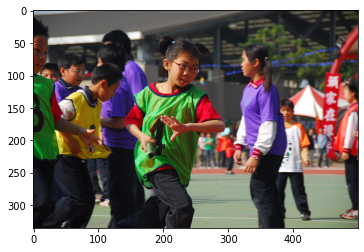

Real Caption: girl running in race
Predicted Caption: group of people in sports uniforms are standing in the street
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


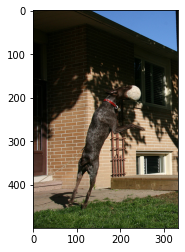

Real Caption: dog catches toy outside of brick house
Predicted Caption: black and white dog jumping in the air with stick in its mouth
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


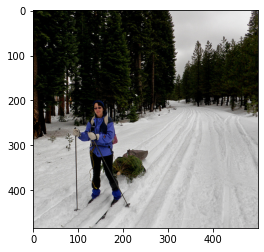

Real Caption: woman is skiing while pulling <unk> down tree behind her
Predicted Caption: man in red jacket and black pants is skiing down snowy hill
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


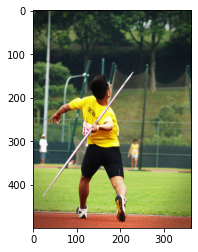

Real Caption: man in yellow shirt and black shorts getting ready to throw javelin
Predicted Caption: woman in white shirt and black shorts is playing tennis
BLEU-1 score: 40.936537653899094
BLEU-2 score: 33.42454302942773
BLEU-3 score: 31.555693644821787
BLEU-4 score: 22.741221234802104


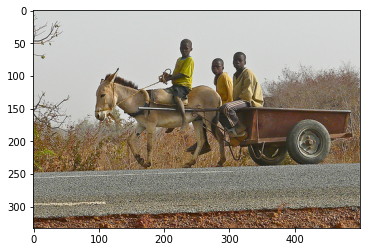

Real Caption: donkey is pulling the cart down the road
Predicted Caption: two men in uniform are riding on horses
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


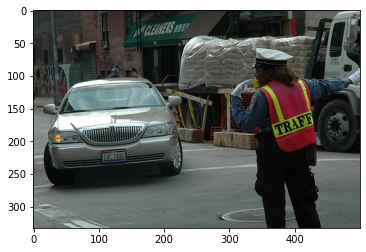

Real Caption: police officer wearing dark pants blue shirt white gloves white hat and an orange traffic vest is standing in the street directing vehicles
Predicted Caption: man in blue shirt and black pants is standing on the street
BLEU-1 score: 29.988724075863548
BLEU-2 score: 18.08388103657034
BLEU-3 score: 1.2570049972356105e-91
BLEU-4 score: 4.0111268713199815e-153


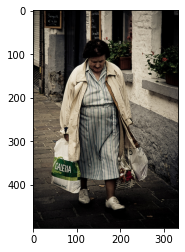

Real Caption: large elderly woman in green <unk> dress is carrying shopping bags along cobbled street
Predicted Caption: woman in black and white dress is walking down the street
BLEU-1 score: 34.60456303167608
BLEU-2 score: 22.95407032205458
BLEU-3 score: 1.8764697784739664e-91
BLEU-4 score: 6.235626511094914e-153


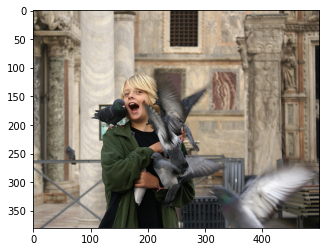

Real Caption: boy is surrounded by pigeons
Predicted Caption: man in black shirt and woman in black dress are standing in front of an old building
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


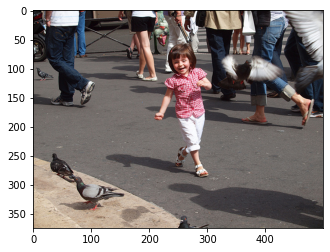

Real Caption: girl in red checked top is chasing pigeons on street
Predicted Caption: young girl in pink and black pants is jumping in the air
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


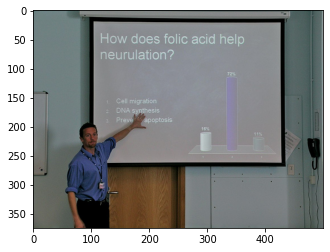

Real Caption: teacher teaching about <unk> <unk> and how it helps <unk>
Predicted Caption: man in blue shirt is standing in front of an atm sign
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


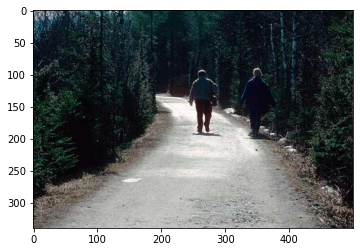

Real Caption: an older man and woman walk along forest path
Predicted Caption: two people are walking down dirt road
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


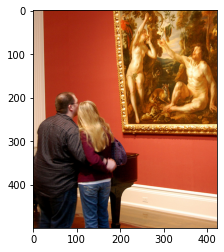

Real Caption: the man and woman look at painting of naked people
Predicted Caption: man in black shirt and woman in black shirt are standing in front of an open door
BLEU-1 score: 23.529411764705884
BLEU-2 score: 12.126781251816652
BLEU-3 score: 1.4270876757460378e-91
BLEU-4 score: 5.194514794593801e-153


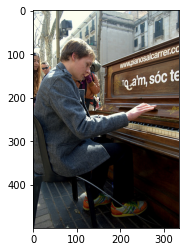

Real Caption: man in denim jacket playing the piano in the street
Predicted Caption: man in black shirt and black pants is sitting at restaurant
BLEU-1 score: 18.181818181818183
BLEU-2 score: 13.483997249264846
BLEU-3 score: 1.5208785072510163e-91
BLEU-4 score: 5.477489369001354e-153


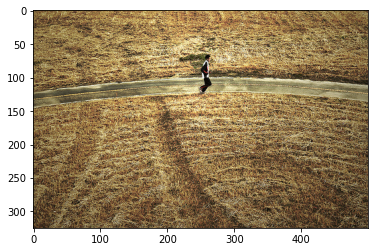

Real Caption: man wearing black and white jump suite is jogging down road
Predicted Caption: person in blue shirt is walking down dirt road
BLEU-1 score: 26.691246763893595
BLEU-2 score: 6.89607067075869e-153
BLEU-3 score: 1.4748926031503012e-183
BLEU-4 score: 1.1084551487393798e-229


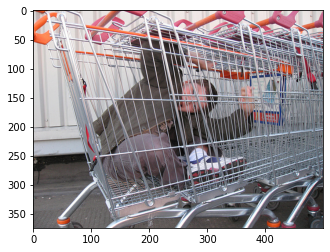

Real Caption: young boy <unk> in shopping cart
Predicted Caption: man in white shirt is standing in front of an old building
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


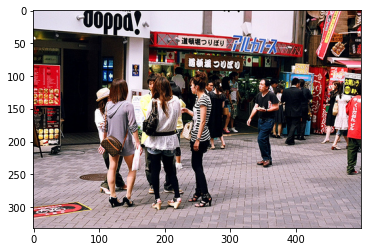

Real Caption: five asian teenagers are talking in group outside store
Predicted Caption: group of people are walking down the street in the street
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


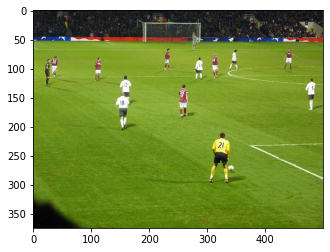

Real Caption: two teams one wearing black and white one wearing red and white and man in yellow and black play football soccer in stadium
Predicted Caption: soccer player in blue jersey is about to hit the ball
BLEU-1 score: 6.10747238616659
BLEU-2 score: 2.1365598972213878e-153
BLEU-3 score: 5.158483592876113e-184
BLEU-4 score: 3.996150654699218e-230


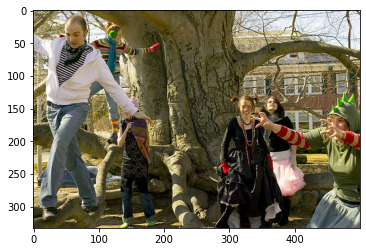

Real Caption: people play on big tree
Predicted Caption: group of people are standing in front of an outdoor building
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


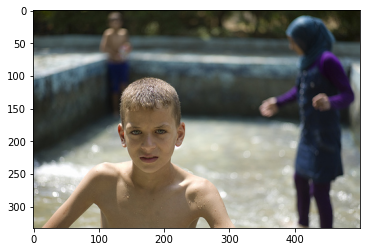

Real Caption: the image <unk> are broken
Predicted Caption: young boy in blue shirt is playing in fountain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


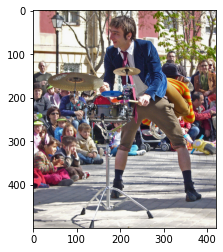

Real Caption: man is standing while playing the drums for an audience
Predicted Caption: man in red shirt is playing guitar
BLEU-1 score: 27.91881675133095
BLEU-2 score: 6.361471949532527e-153
BLEU-3 score: 1.2938603872273248e-183
BLEU-4 score: 9.602579706020655e-230


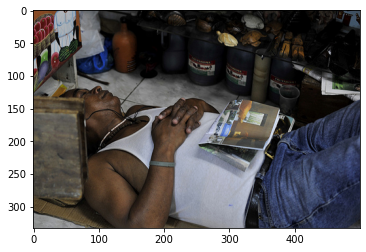

Real Caption: man who is laying on the floor with headphones on and eyes closed
Predicted Caption: man in blue shirt is sitting on the floor
BLEU-1 score: 35.62113269055304
BLEU-2 score: 23.89538223948497
BLEU-3 score: 19.781128734900083
BLEU-4 score: 2.939061704420706e-76


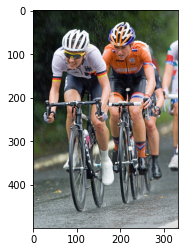

Real Caption: group of bicycle racers in close <unk> peddling on paved surface
Predicted Caption: group of people are riding bikes in the street
BLEU-1 score: 26.691246763893595
BLEU-2 score: 16.34498379256302
BLEU-3 score: 1.5618167350796274e-91
BLEU-4 score: 5.396466934950335e-153


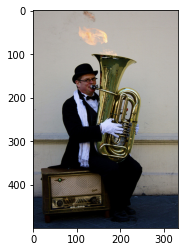

Real Caption: man is sitting on an old radio playing tuba with fire coming out of it
Predicted Caption: man in black shirt and sunglasses is playing the accordion
BLEU-1 score: 18.195919791379005
BLEU-2 score: 4.955478567099638e-153
BLEU-3 score: 1.0824199654502182e-183
BLEU-4 score: 8.177892479606618e-230


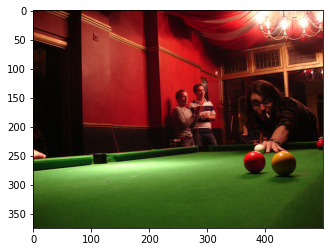

Real Caption: man wearing black shirt leans over pool table to take shot
Predicted Caption: man in black shirt is playing pool
BLEU-1 score: 32.26960697187196
BLEU-2 score: 17.42757960201972
BLEU-3 score: 1.411491490766853e-91
BLEU-4 score: 4.679577191845681e-153


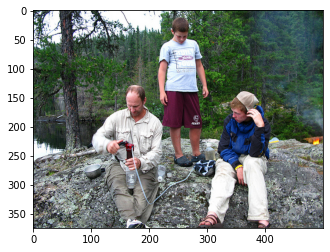

Real Caption: man and two boys are <unk> water near their campsite in the woods
Predicted Caption: two children are playing in the woods
BLEU-1 score: 30.31234611978214
BLEU-2 score: 20.7072745526756
BLEU-3 score: 17.02479136829039
BLEU-4 score: 2.421189997705526e-76


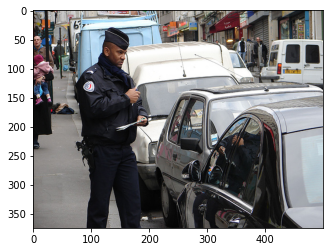

Real Caption: the policeman is having note in his hand
Predicted Caption: man in black shirt and black pants is standing in the street
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


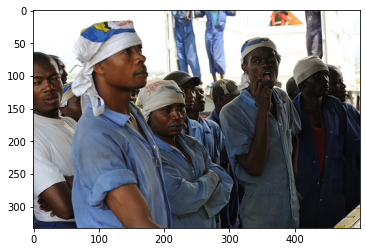

Real Caption: an angry crowd gathering to hear speech
Predicted Caption: group of people are standing in the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


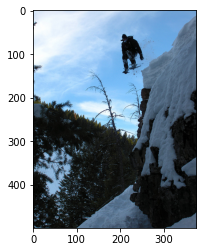

Real Caption: this person participates in winter sports as shown
Predicted Caption: man is standing on top of mountain
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


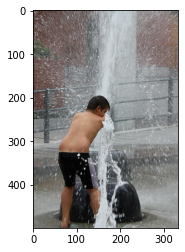

Real Caption: boy in shorts stands next to jet of water
Predicted Caption: boy in blue shirt is playing in water
BLEU-1 score: 33.09363384692233
BLEU-2 score: 20.42583425999594
BLEU-3 score: 1.8560791299878595e-91
BLEU-4 score: 6.33313451367699e-153


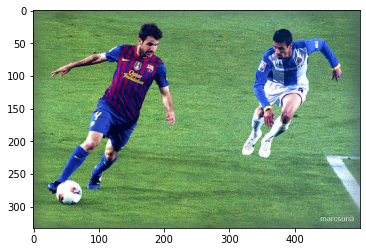

Real Caption: two professional soccer players are playing with ball on the field
Predicted Caption: two soccer players playing soccer
BLEU-1 score: 24.09553695297616
BLEU-2 score: 13.469814645303213
BLEU-3 score: 9.405003247338848e-92
BLEU-4 score: 3.004528558042487e-153


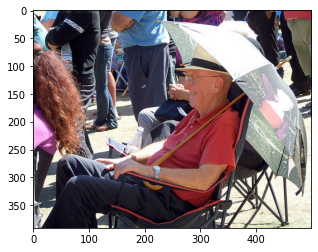

Real Caption: an elderly man enjoys the view under an umbrella to prevent the sun <unk>
Predicted Caption: woman in red shirt is holding an umbrella
BLEU-1 score: 11.809163818525366
BLEU-2 score: 8.926888758697146
BLEU-3 score: 8.797009451835858e-92
BLEU-4 score: 3.0631047335730513e-153


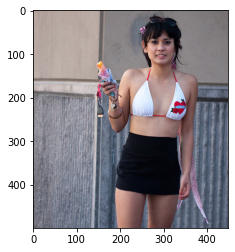

Real Caption: an asian woman in bikini top and black skirt holds popsicle and set of keys
Predicted Caption: woman in black shirt and black pants is holding microphone
BLEU-1 score: 24.26122638850534
BLEU-2 score: 18.08325047406988
BLEU-3 score: 1.484944874730289e-91
BLEU-4 score: 4.940112557120433e-153


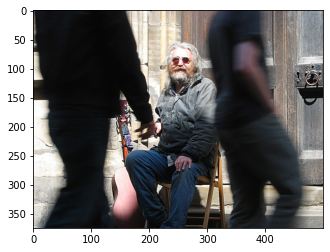

Real Caption: man with gray hair and bear sits in chair on the street with guitar by his side
Predicted Caption: two men are sitting on bench in the street
BLEU-1 score: 18.271657355874996
BLEU-2 score: 9.690009614892206
BLEU-3 score: 8.741421028315024e-92
BLEU-4 score: 2.9772448312487846e-153


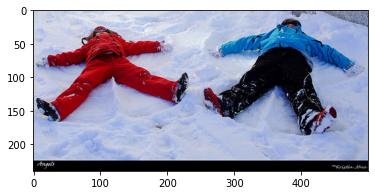

Real Caption: the children make snow angels next to each other
Predicted Caption: two people are playing in the snow
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229


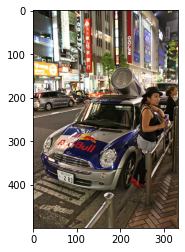

Real Caption: woman in red shoes standing next to red bull car
Predicted Caption: man in black shirt and black pants is riding bike
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


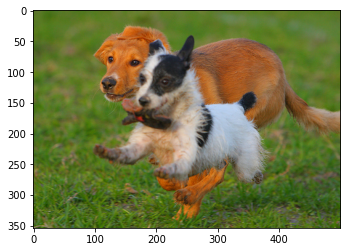

Real Caption: two dogs are running together through the grass
Predicted Caption: two dogs playing in the grass
BLEU-1 score: 47.76875403825262
BLEU-2 score: 37.00151777184613
BLEU-3 score: 2.4390972795164994e-91
BLEU-4 score: 7.680678231212098e-153


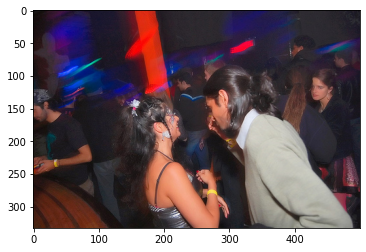

Real Caption: men and women are dancing at nightclub
Predicted Caption: man in black shirt is holding microphone
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


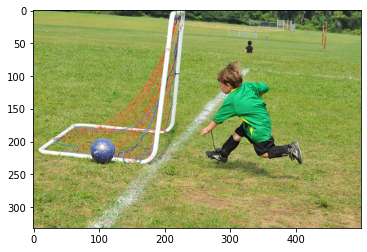

Real Caption: the little kid just <unk> soccer kick for the goal
Predicted Caption: young boy in blue soccer uniform is playing soccer
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230


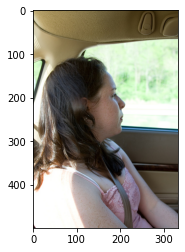

Real Caption: young girl looking out of car window
Predicted Caption: woman in black shirt and black pants is sitting on bench
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


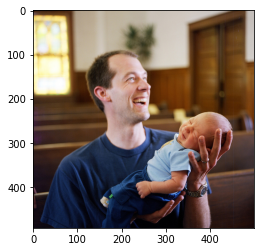

Real Caption: man in blue smiles while holding baby in light blue shirt
Predicted Caption: man in white shirt and black pants is holding up his hands
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


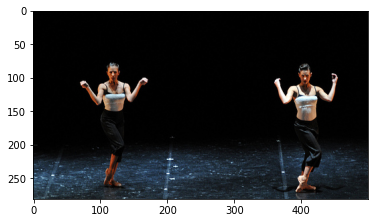

Real Caption: two brunette women in modern dance pose on dark black stage while wearing matching outfits of white <unk> and black capri pants
Predicted Caption: two people are playing in the snow
BLEU-1 score: 3.3519761741214507
BLEU-2 score: 9.354210977457987e-154
BLEU-3 score: 2.0632659585528062e-184
BLEU-4 score: 1.5626448314168793e-230


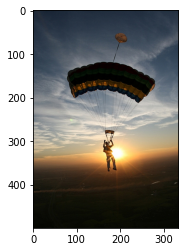

Real Caption: person is parachuting while the sun is setting in background
Predicted Caption: man is jumping off of the side of the water
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


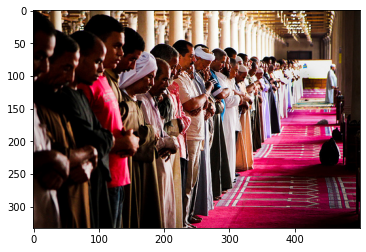

Real Caption: group of people gather together to <unk>
Predicted Caption: group of people are gathered outside
BLEU-1 score: 42.324086244530704
BLEU-2 score: 37.855813571333776
BLEU-3 score: 34.45946953219957
BLEU-4 score: 4.888731610154635e-76


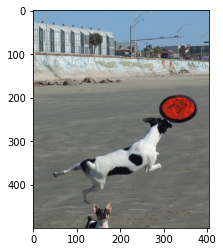

Real Caption: black and white dog leaps for flying disc while another one watches
Predicted Caption: black and white dog jumping in the air
BLEU-1 score: 30.326532985631673
BLEU-2 score: 28.076913794513086
BLEU-3 score: 27.47984940312521
BLEU-4 score: 20.969025558524574


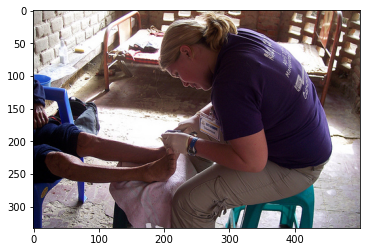

Real Caption: young woman is taking care of the person feet
Predicted Caption: woman in black and white striped shirt is holding an infant
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


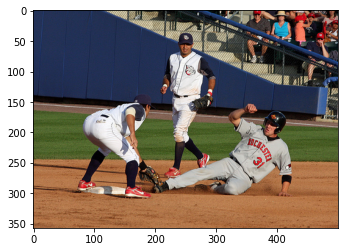

Real Caption: baseball player is tagged out sliding into second base
Predicted Caption: baseball player in white uniform is sliding into base
BLEU-1 score: 66.66666666666666
BLEU-2 score: 40.8248290463863
BLEU-3 score: 2.956364334412574e-91
BLEU-4 score: 9.530910758639079e-153


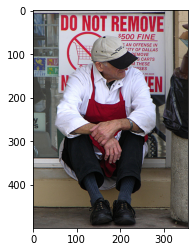

Real Caption: man in an apron sits on curb
Predicted Caption: man in black shirt and black pants is sitting on bench
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


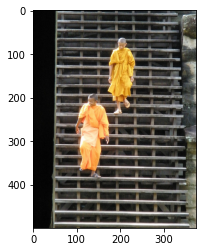

Real Caption: two monks are walking down steep stairs
Predicted Caption: two men in orange vests are standing in front of an orange building
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229


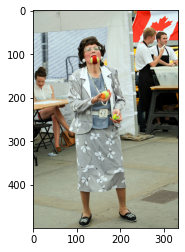

Real Caption: woman in gray dress is juggling tennis balls
Predicted Caption: man in white shirt and black pants is holding an umbrella
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


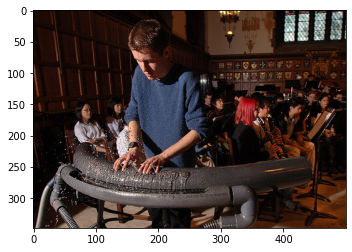

Real Caption: man is in an ornate wood <unk> room standing and playing an unusual instrument while being accompanied by wind ensemble <unk> of young people who are sitting behind him
Predicted Caption: man in black shirt is playing the drums
BLEU-1 score: 3.6219878517125728
BLEU-2 score: 7.640718556541334e-154
BLEU-3 score: 1.5068660392630153e-184
BLEU-4 score: 1.109756786750766e-230


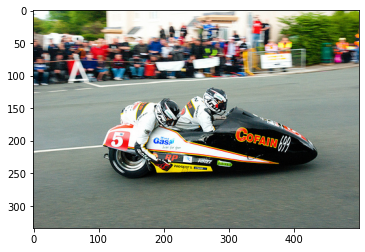

Real Caption: two racers on one racing bike that has <unk> and the number on it
Predicted Caption: two men are riding on motorcycle
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230


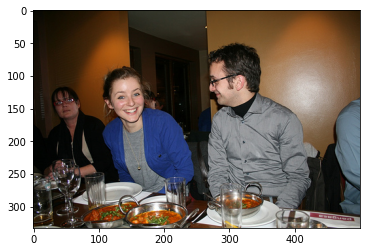

Real Caption: two women look at the camera while young man with glasses looks at one of them
Predicted Caption: man in black shirt and woman in black shirt are talking
BLEU-1 score: 5.770331081275289
BLEU-2 score: 2.854757945924487e-153
BLEU-3 score: 7.917394236512313e-184
BLEU-4 score: 6.3497053018839555e-230


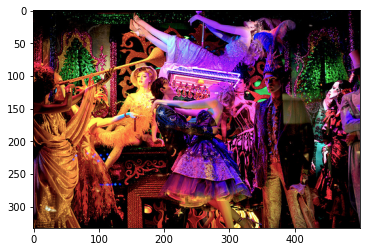

Real Caption: set of actors and <unk> perform show
Predicted Caption: group of people are gathered outside
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


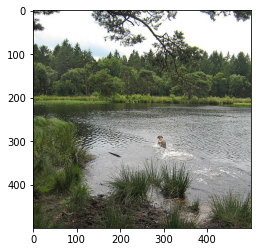

Real Caption: dog running into pond to fetch something
Predicted Caption: two people are wading in the water
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


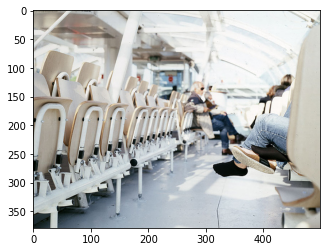

Real Caption: photo of an inside of place with chairs and people sitting in them
Predicted Caption: group of people are gathered around the subway station
BLEU-1 score: 14.248453076221212
BLEU-2 score: 4.5086465338368087e-153
BLEU-3 score: 1.0457385906395474e-183
BLEU-4 score: 8.020204191025903e-230


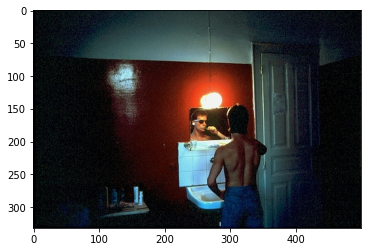

Real Caption: man that is not wearing shirt is brushing his teeth
Predicted Caption: man in black shirt and black pants is standing in front of microphone
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


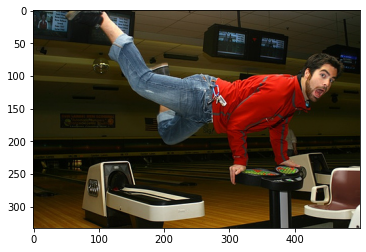

Real Caption: man in red jacket with jeans on balancing at bowling alley
Predicted Caption: young girl in red shirt is jumping in the air
BLEU-1 score: 18.096748360719193
BLEU-2 score: 13.488519835425333
BLEU-3 score: 1.4615380524992383e-91
BLEU-4 score: 5.21122277279896e-153


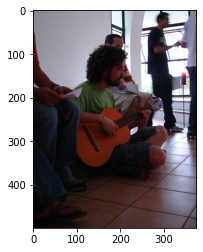

Real Caption: man sitting on the ground playing guitar
Predicted Caption: man in black shirt and black pants is sitting on the floor
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 21.614978940479492
BLEU-4 score: 3.4077295621678845e-76


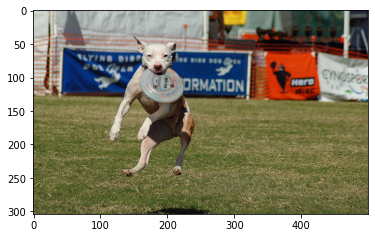

Real Caption: the dog jumps to catch the frisbee
Predicted Caption: dog runs on the grass with his tongue out
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


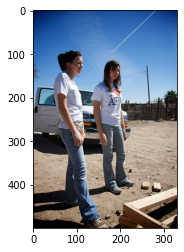

Real Caption: two white girls with brown hair are standing in front of van
Predicted Caption: two girls are walking down the street
BLEU-1 score: 20.980356838155135
BLEU-2 score: 4.780501720609066e-153
BLEU-3 score: 9.723067014109315e-184
BLEU-4 score: 7.2161206040200775e-230


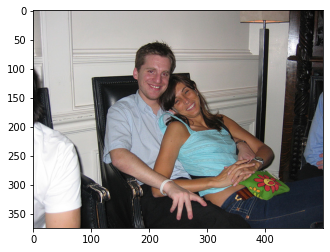

Real Caption: smiling man and woman <unk> together while posing for picture
Predicted Caption: man in white shirt and woman in black shirt are sitting on the ground
BLEU-1 score: 21.428571428571423
BLEU-2 score: 12.838814775327384
BLEU-3 score: 1.47678845808219e-91
BLEU-4 score: 5.344839673067705e-153


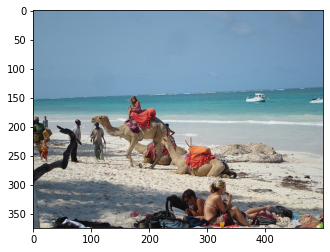

Real Caption: girl is riding camels on the beach
Predicted Caption: group of people are sitting on the beach in the desert
BLEU-1 score: 27.27272727272727
BLEU-2 score: 23.35496832484569
BLEU-3 score: 21.61497894047949
BLEU-4 score: 3.4077295621678845e-76


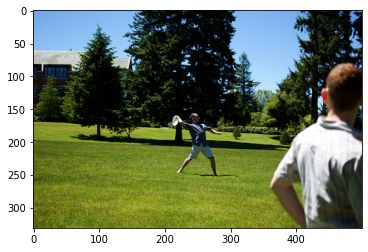

Real Caption: man in blue and shorts is throwing frisbee in an outdoor scene while another watches
Predicted Caption: man in black shirt and black pants is playing soccer
BLEU-1 score: 24.26122638850534
BLEU-2 score: 12.786789036109663
BLEU-3 score: 1.2061500329565798e-91
BLEU-4 score: 4.1541229402322545e-153


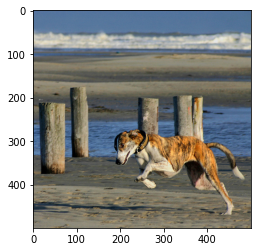

Real Caption: brown dog is running past wooden posts on the beach
Predicted Caption: dog runs on the beach
BLEU-1 score: 29.430355293715387
BLEU-2 score: 23.266738769033594
BLEU-3 score: 20.09958724592169
BLEU-4 score: 2.7150404862408692e-76


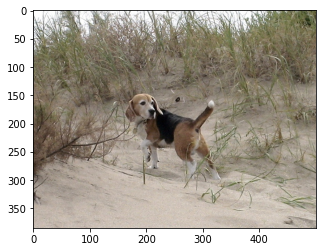

Real Caption: brown black and white dog standing on sandy slope
Predicted Caption: two dogs running on the dirt road
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


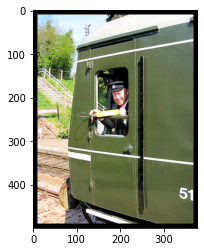

Real Caption: man who is in train <unk> he is conductor
Predicted Caption: man in blue shirt is standing in front of an open window
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


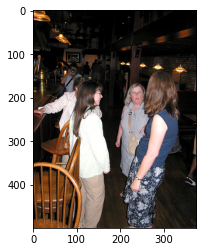

Real Caption: man taking photograph of four ladies in bar
Predicted Caption: woman in black and white striped shirt is holding drink
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


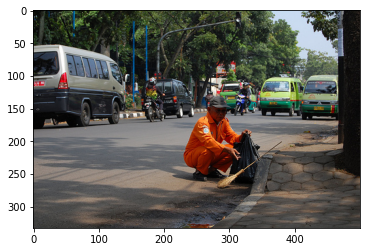

Real Caption: an older gentleman in an orange jumpsuit and gray hat is on the curb with black trash bag and broom
Predicted Caption: man in red shirt is standing on the street
BLEU-1 score: 13.092214591560325
BLEU-2 score: 6.943195288831331
BLEU-3 score: 6.263501865695844e-92
BLEU-4 score: 2.1332891408337312e-153


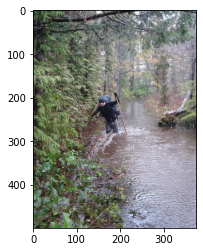

Real Caption: hiker with backpack wades in river
Predicted Caption: man is walking down trail in the woods
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


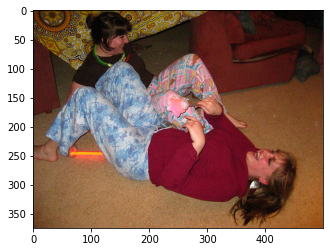

Real Caption: two women are laughing on the floor with toy <unk>
Predicted Caption: two children are playing with an adult
BLEU-1 score: 27.91881675133095
BLEU-2 score: 6.361471949532527e-153
BLEU-3 score: 1.2938603872273248e-183
BLEU-4 score: 9.602579706020655e-230


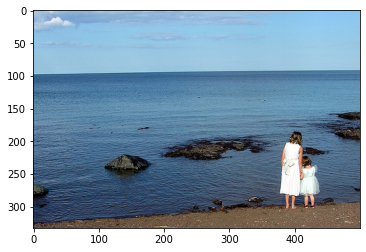

Real Caption: little girl and an older girl in white dresses stand together at the edge of body of water with their backs to the camera
Predicted Caption: two girls are standing on the beach in front of the ocean
BLEU-1 score: 12.262648039048077
BLEU-2 score: 3.168232950523297e-153
BLEU-3 score: 6.776037495668201e-184
BLEU-4 score: 5.092529201164552e-230


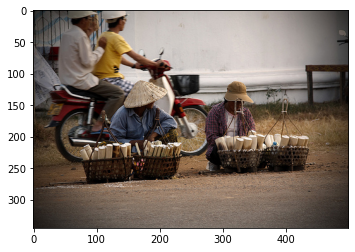

Real Caption: two asian men with hard hats on red scooter pass by two people kneeling down on the road with two baskets at their sides
Predicted Caption: group of people are riding on horses
BLEU-1 score: 2.5189339817816414
BLEU-2 score: 7.029477144195254e-154
BLEU-3 score: 1.5504975174276478e-184
BLEU-4 score: 1.1742921079512431e-230


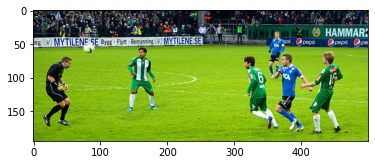

Real Caption: group of men playing soccer most of them looking at one man in black
Predicted Caption: two soccer players are playing soccer
BLEU-1 score: 8.786571270524224
BLEU-2 score: 6.806048840200973
BLEU-3 score: 5.9199309684733726e-92
BLEU-4 score: 1.9979751932053748e-153


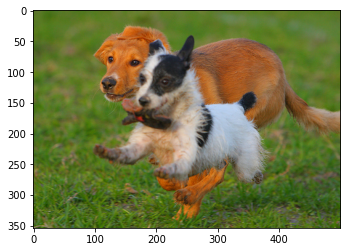

Real Caption: two dogs are running together through the grass
Predicted Caption: two dogs playing in the grass
BLEU-1 score: 47.76875403825262
BLEU-2 score: 37.00151777184613
BLEU-3 score: 2.4390972795164994e-91
BLEU-4 score: 7.680678231212098e-153


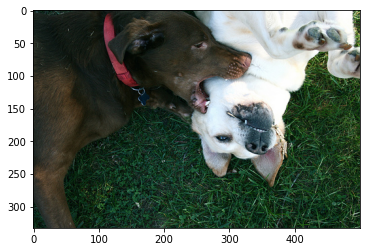

Real Caption: brown dog playfully bites white dog
Predicted Caption: two dogs fight in the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


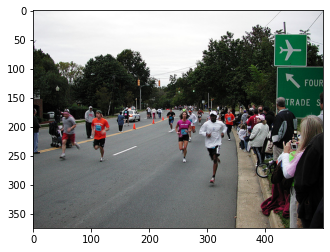

Real Caption: people run marathon on city street with crowd watching
Predicted Caption: group of people are walking down the street in the street
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


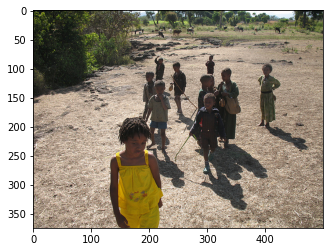

Real Caption: several young children standing in the sun
Predicted Caption: two children are playing in the snow
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153


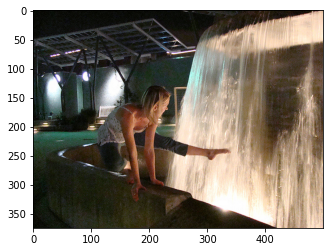

Real Caption: young woman tries to stick her foot in fountain
Predicted Caption: young girl in black pants and black shirt is jumping into pool
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


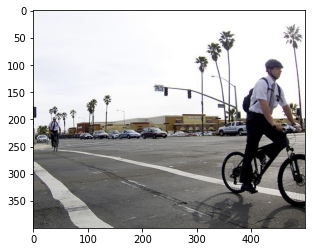

Real Caption: man dressed in slacks and tie is riding bicycle followed by another man doing the same with walmart in the background
Predicted Caption: man in blue shirt and black pants rides bike down the street
BLEU-1 score: 15.745551758033821
BLEU-2 score: 4.0680916344595085e-153
BLEU-3 score: 8.700604368867122e-184
BLEU-4 score: 6.538936929519805e-230


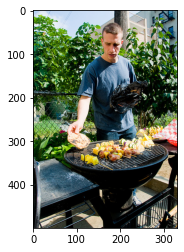

Real Caption: man in blue shirt places <unk> and burgers on grill
Predicted Caption: man in blue shirt is standing in front of vegetable market
BLEU-1 score: 36.36363636363637
BLEU-2 score: 33.02891295379082
BLEU-3 score: 32.76218166485813
BLEU-4 score: 23.462350320528


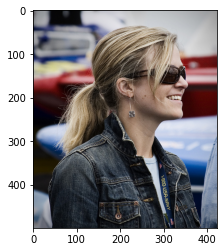

Real Caption: blond woman wearing sunglasses and <unk> earrings smiles
Predicted Caption: woman in black and white striped shirt is holding drink
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


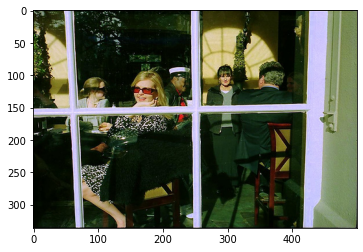

Real Caption: five people are sitting inside building
Predicted Caption: two men are sitting in subway
BLEU-1 score: 33.33333333333333
BLEU-2 score: 25.819888974716115
BLEU-3 score: 2.2458252053838132e-91
BLEU-4 score: 7.57965434483665e-153


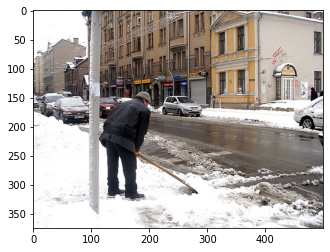

Real Caption: man shovels <unk> of the street
Predicted Caption: man in blue shirt and black pants is shoveling snow in the snow
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229


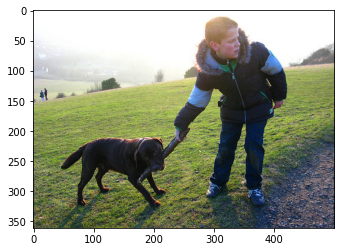

Real Caption: boy and dog hold onto the same stick in game
Predicted Caption: man in black shirt and black pants is playing with dog
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


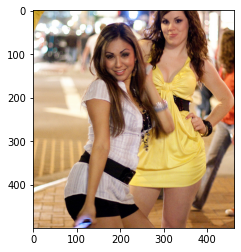

Real Caption: two girls getting ready for beauty contest <unk> by the <unk> <unk> officer
Predicted Caption: two girls are posing for picture
BLEU-1 score: 15.570161195729886
BLEU-2 score: 9.847434582895442
BLEU-3 score: 7.898169211184705e-92
BLEU-4 score: 2.612133206556599e-153


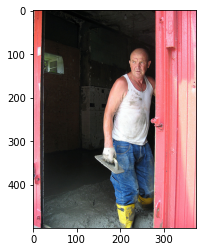

Real Caption: man is smoothing concrete inside building wearing jeans and
Predicted Caption: man in blue shirt and blue pants is standing outside
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229


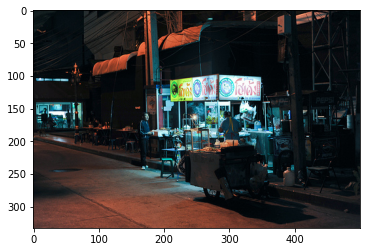

Real Caption: oriental shop opened late at night
Predicted Caption: man in black shirt is standing in the street
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


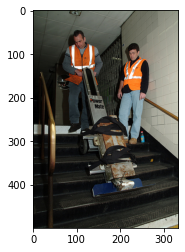

Real Caption: the two floor <unk> haul the machinery <unk>
Predicted Caption: man in blue shirt and black pants is standing on the sidewalk
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


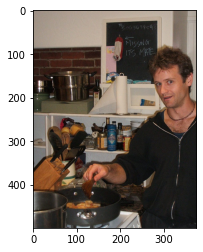

Real Caption: man wearing black sweater cooks food in pan while standing in cluttered kitchen
Predicted Caption: man in black shirt is cooking in kitchen
BLEU-1 score: 33.453839282436896
BLEU-2 score: 6.312162534695081e-153
BLEU-3 score: 1.1905197729661826e-183
BLEU-4 score: 8.670502677906936e-230


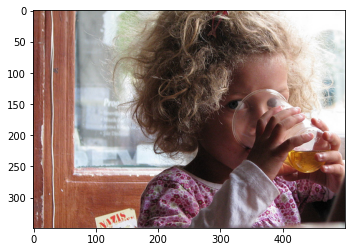

Real Caption: little curly hair girl drinking from big cup
Predicted Caption: woman in black shirt is holding drink
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


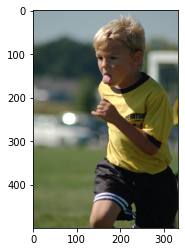

Real Caption: young blond boy in soccer outfit is running with his tongue sticking out
Predicted Caption: young boy in blue shirt and blue shorts is running in the grass
BLEU-1 score: 38.46153846153847
BLEU-2 score: 25.318484177091666
BLEU-3 score: 2.2195551978722937e-91
BLEU-4 score: 7.505697654413981e-153


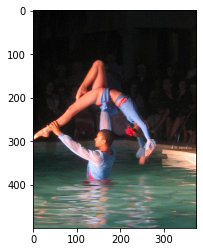

Real Caption: team of man and woman performing water gymnastics with the man holding the female partner high above his head in an <unk> pose
Predicted Caption: young boy jumping into the water
BLEU-1 score: 1.9605490547476627
BLEU-2 score: 5.065362796509841e-154
BLEU-3 score: 1.0833511542339169e-184
BLEU-4 score: 8.141922755856149e-231


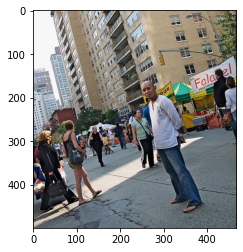

Real Caption: people walking around city market on city street
Predicted Caption: man in blue shirt is walking down the street
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


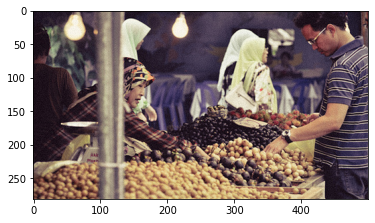

Real Caption: man and woman standing at counter piled with potatoes
Predicted Caption: man in blue shirt is standing in front of vegetable market
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


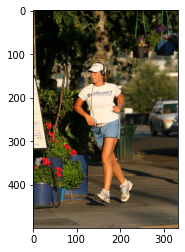

Real Caption: man in shorts is jogging along street with headset
Predicted Caption: woman in black and white dress is walking down the street
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


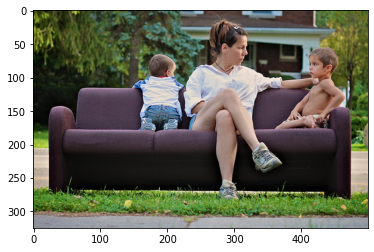

Real Caption: woman and two children sit on sofa outside
Predicted Caption: two girls sitting on bench in park
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


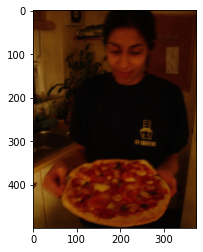

Real Caption: latin woman shows off homemade pizza in kitchen
Predicted Caption: woman in black shirt is holding drink
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


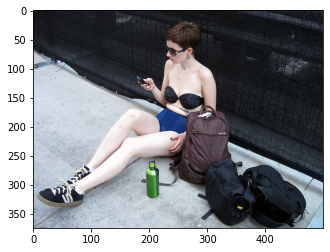

Real Caption: woman siting in black polka dot bathing suit top and blue high waist underwear bottoms sitting in the sidewalk with three bags and green bottle
Predicted Caption: woman in black and white striped shirt is sitting on bench
BLEU-1 score: 12.730307310074943
BLEU-2 score: 5.971043403457093
BLEU-3 score: 5.607097315290343e-92
BLEU-4 score: 1.9289817285109407e-153


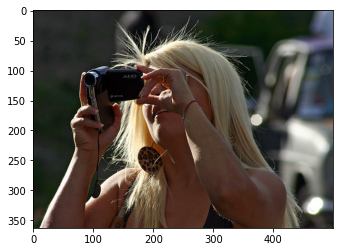

Real Caption: blond woman taking video
Predicted Caption: woman in black and white striped shirt is holding an umbrella
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


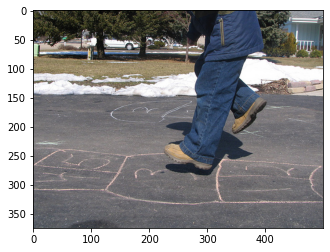

Real Caption: the legs of child playing hopscotch
Predicted Caption: man in blue shirt and black pants is jumping in the air
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


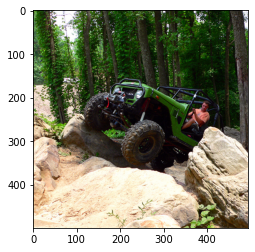

Real Caption: man drives jeep over rough rocks
Predicted Caption: man in blue shirt is driving in the dirt
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


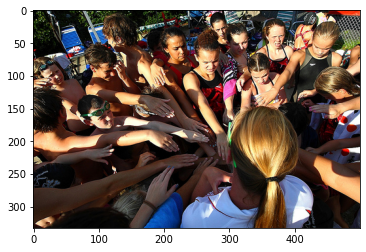

Real Caption: team of people putting their hands in the middle
Predicted Caption: group of people are gathered around in the park
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153


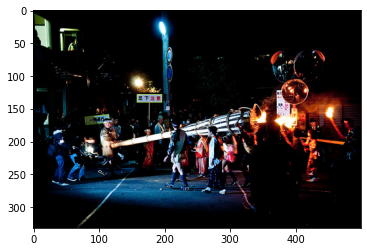

Real Caption: festival involving chinese or japanese people in the street lighting large torch
Predicted Caption: group of people in uniform are playing instruments
BLEU-1 score: 15.163266492815836
BLEU-2 score: 11.462352058111218
BLEU-3 score: 1.1295583726999537e-91
BLEU-4 score: 3.9331043318843304e-153


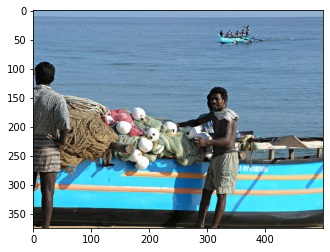

Real Caption: three or two fishermen are standing next to very bright aqua colored boat with yellow <unk> that has <unk> ropes and nets and an identical boat with people in the water in the distance
Predicted Caption: two men are standing in the water with fishing pole
BLEU-1 score: 6.3502567302588755
BLEU-2 score: 4.38209346253364
BLEU-3 score: 3.1416607258941043
BLEU-4 score: 4.578793428647094e-77


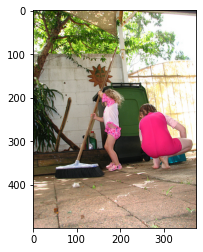

Real Caption: there are two children one with broom the other with dustpan that are cleaning up the concrete in front of green trashcan
Predicted Caption: man in red shirt and black pants is standing on ladder
BLEU-1 score: 3.3443585561040203
BLEU-2 score: 1.6545556966461726e-153
BLEU-3 score: 4.5887497240585767e-184
BLEU-4 score: 3.6801512696566826e-230


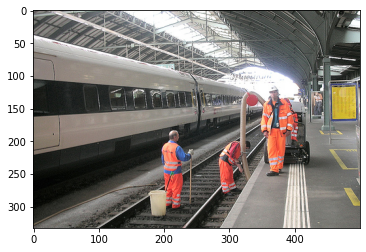

Real Caption: men in orange doing clean up beside of subway
Predicted Caption: two men in orange vests are working on the street
BLEU-1 score: 30.0
BLEU-2 score: 25.819888974716104
BLEU-3 score: 23.781849487482358
BLEU-4 score: 3.6901226086395757e-76


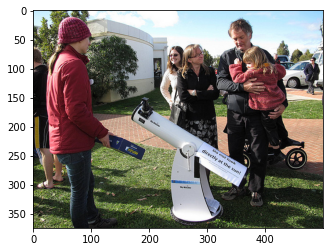

Real Caption: the family is standing near telescope
Predicted Caption: group of people are playing game of
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
BLEU-1 count: 177
BLEU-2 count: 82
BLEU-3 count: 22
BLEU-4 count: 7
BLEU-1 Total: 44.54299929911947
BLEU-2 Total: 18.3036028337179
BLEU-3 Total: 6.384213602840242
BLEU-4 Total: 1.9859627645943783
BLEU-1 Average: 0.25165536327186144
BLEU-2 Average: 0.22321466870387682
BLEU-3 Average: 0.2901915274018292
BLEU-4 Average: 0.2837089663706255


'\nprint(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")\nprint(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")\nprint(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")\nprint(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")\n'

In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")
"""
print(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")
print(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")
print(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")
print(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")
"""